# Predicting house sale price - Modeling
## Capstone Two 

## 1. Import the necessary libraries and the data:

In [288]:
import os
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pickle

# ignore warning messages to ensure clean outputs
import warnings
warnings.filterwarnings('ignore')

In [289]:
tf_train = pd.read_csv('transformed_train.csv')
tf_test = pd.read_csv('transformed_test.csv')
tf_train.head()

,Id,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,ExterQual,ExterCond,...,GarageType_Detchd,GarageCond_Others,GarageCond_TA,SaleType_New,SaleType_Others,SaleType_WD,SaleCondition_Others,SaleCondition_Partial,MoSold_sin,MoSold_cos
0,1,4.189655,9.042040,0.625,0.0,123,53,5.283204,0.5,0.0,...,0,0,1,0,0,1,0,0,8.660254e-01,5.000000e-01
1,2,4.394449,9.169623,0.500,3.0,96,26,0.000000,0.0,0.0,...,0,0,1,0,0,1,0,0,5.000000e-01,-8.660254e-01
2,3,4.234107,9.328212,0.625,0.0,121,52,5.093750,0.5,0.0,...,0,0,1,0,0,1,0,0,-1.000000e+00,-1.836970e-16
3,4,4.110874,9.164401,0.625,0.0,35,20,0.000000,0.0,0.0,...,1,0,1,0,0,1,1,0,8.660254e-01,5.000000e-01
4,5,4.442651,9.565284,0.750,0.0,120,50,5.860786,0.5,0.0,...,0,0,1,0,0,1,0,0,-2.449294e-16,1.000000e+00


In [290]:
X_tf_train = tf_train.drop(columns=["SalePrice", "Id"])
y_tf_train = tf_train['SalePrice']

## 2. Models

In [291]:
# pip install optuna

In [292]:
from sklearn import __version__ as sklearn_version
from sklearn.decomposition import PCA
from sklearn.model_selection import cross_validate, GridSearchCV, learning_curve, RandomizedSearchCV
from sklearn.model_selection import cross_val_score, KFold
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error, make_scorer
from sklearn.pipeline import make_pipeline
from sklearn.feature_selection import SelectKBest, f_regression
from scipy.stats import randint
import optuna
import lightgbm as lgb
import optuna.visualization as vis

import shap
shap.initjs()


# from library.sb_utils import save_file

In [293]:
model_compare = {}

### 2.1 The Linear Models

#### 2.1.1 Initial Linear model

In [294]:
lr = LinearRegression().fit(X_tf_train, y_tf_train)
y_tf_tr_pred = lr.predict(X_tf_train)

Assess model performance

In [295]:
lr_ini_r2 = r2_score(y_tf_train, y_tf_tr_pred)
lr_ini_mae = mean_absolute_error(y_tf_train, y_tf_tr_pred)
lr_ini_rmse = np.sqrt(mean_squared_error(y_tf_train, y_tf_tr_pred))
print(f"R2:{lr_ini_r2}")
print(f"Mean absolute error: {lr_ini_mae}")
print(f"Root mean squared error: {lr_ini_rmse}")

R2:0.9223457769959544
Mean absolute error: 0.07044468814297856
Root mean squared error: 0.10497454480666878


In [296]:
model_compare['lr_outfit_training(reference_only)'] = [round(lr_ini_r2, 4), round(lr_ini_mae, 4), round(lr_ini_rmse, 4)]

I suspected the model may be overfitting given the number of features I blindly used. It's likely a judicious subset of features would generalize better. `sklearn` has a number of feature selection functions available. The one I'll use here is `SelectKBest` which selects the k best features (Ref. about SelectKBest 
[here](https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.SelectKBest.html#sklearn.feature_selection.SelectKBest)). `f_regression` is just the [score function](https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.f_regression.html#sklearn.feature_selection.f_regression) I'm using because I'm performing regression. It's important to choose an appropriate one for my machine learning task.

#### 2.1.2 Linear Regression: Default Hyperparameters & Cross-Validation

In [297]:
lr = LinearRegression().fit(X_tf_train, y_tf_train)

# Define scoring metrics
scoring = {
    'r2':'r2', 
    'mae': 'neg_mean_absolute_error', 
    'rmse': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False)
}
# Perform cross-validation
lr_default_cv_results = cross_validate(lr, X_tf_train, y_tf_train, cv=5, scoring=scoring)
lr_default_r2_scores = lr_default_cv_results['test_r2']
lr_default_mae_scores = -lr_default_cv_results['test_mae']
lr_default_rmse_scores = -lr_default_cv_results['test_rmse']

print(f"R² Scores: {lr_default_r2_scores}")
print(f"Mean R²: {np.mean(lr_default_r2_scores):.4f}")
print(f"MAE Scores: {lr_default_mae_scores}")
print(f"Mean MAE: {np.mean(lr_default_mae_scores):.4f}")
print(f"RMSE Scores: {lr_default_rmse_scores}")
print(f"Mean RMSE: {np.mean(lr_default_rmse_scores):.4f}")

R² Scores: [0.90402632 0.88535631 0.87260892 0.91188059 0.81608188]
Mean R²: 0.8780
MAE Scores: [0.08029934 0.08486135 0.08582648 0.08577071 0.0884397 ]
Mean MAE: 0.0850
RMSE Scores: [0.114507   0.13427169 0.13607023 0.11249526 0.1517145 ]
Mean RMSE: 0.1298


In [298]:
model_compare['lr_cv_default'] = [round(np.mean(lr_default_r2_scores), 4), round(np.mean(lr_default_mae_scores), 4), round(np.mean(lr_default_rmse_scores), 4)]

#### 2.1.3 Hyperparameter search using GridSearchCV

In [299]:
# Define pipeline
pipe = make_pipeline(
    SelectKBest(f_regression),
    LinearRegression()
)

In [300]:
# Define grid parameters
k = [k+1 for k in range(len(X_tf_train.columns))]
grid_params = {'selectkbest__k':k}

# Define scoring metrics
scoring = {
    'r2':'r2', 
    'mae': 'neg_mean_absolute_error', 
    'rmse': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False)
}

# Perform Grid Search with Cross-Validation
lr_grid_cv = GridSearchCV(pipe, param_grid=grid_params, cv=5, n_jobs=-1, scoring=scoring, refit='r2')
lr_grid_cv.fit(X_tf_train, y_tf_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('selectkbest',
                                        SelectKBest(score_func=<function f_regression at 0x000002CA876E3920>)),
                                       ('linearregression',
                                        LinearRegression())]),
             n_jobs=-1,
             param_grid={'selectkbest__k': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11,
                                            12, 13, 14, 15, 16, 17, 18, 19, 20,
                                            21, 22, 23, 24, 25, 26, 27, 28, 29,
                                            30, ...]},
             refit='r2',
             scoring={'mae': 'neg_mean_absolute_error', 'r2': 'r2',
                      'rmse': make_scorer(<lambda>, greater_is_better=False, response_method='predict')})

In [301]:
# Extract results
cv_k = [k for k in lr_grid_cv.cv_results_['param_selectkbest__k']]
lr_grid_r2_scores = lr_grid_cv.cv_results_['mean_test_r2']
lr_grid_r2_std = lr_grid_cv.cv_results_['std_test_r2']
lr_grid_mae_scores = -lr_grid_cv.cv_results_['mean_test_mae']
lr_grid_mae_std = lr_grid_cv.cv_results_['std_test_mae']
lr_grid_rmse_scores = -lr_grid_cv.cv_results_['mean_test_rmse']
lr_grid_rmse_std = lr_grid_cv.cv_results_['std_test_rmse']

Text(0.5, 1.0, 'Pipeline mean CV r-squared (error bars +/- 1sd)')

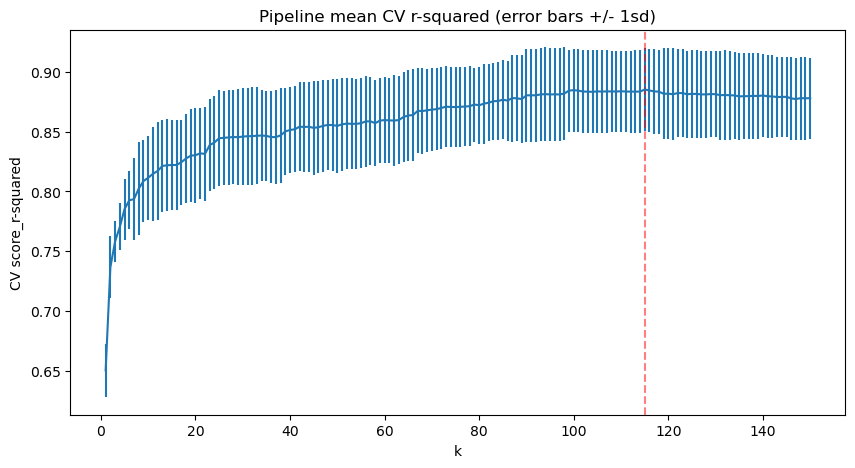

In [302]:
# Assign the value of k from the above dict of 'best_params_' and assign it to 'best_k'
lr_grid_best_k = lr_grid_cv.best_params_['selectkbest__k']
plt.subplots(figsize=(10, 5))
plt.errorbar(cv_k, lr_grid_r2_scores, yerr=lr_grid_r2_std)
plt.axvline(x=lr_grid_best_k, c='r', ls='--', alpha=.5)
plt.xlabel('k')
plt.ylabel('CV score_r-squared')
plt.title('Pipeline mean CV r-squared (error bars +/- 1sd)')

Text(0.5, 1.0, 'Pipeline mean CV MAE (error bars +/- 1sd)')

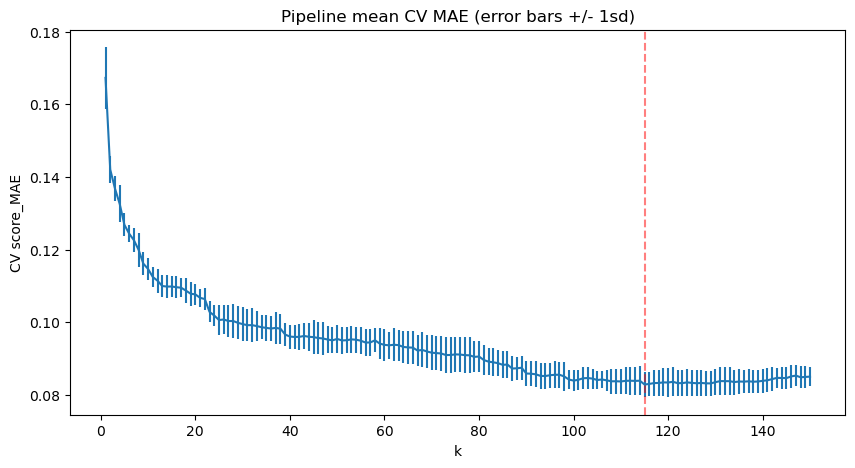

In [303]:
# Assign the value of k from the above dict of 'best_params_' and assign it to 'best_k'
plt.subplots(figsize=(10, 5))
plt.errorbar(cv_k, lr_grid_mae_scores, yerr=lr_grid_mae_std)
plt.axvline(x=lr_grid_best_k, c='r', ls='--', alpha=.5)
plt.xlabel('k')
plt.ylabel('CV score_MAE')
plt.title('Pipeline mean CV MAE (error bars +/- 1sd)')

Text(0.5, 1.0, 'Pipeline mean CV RMSE (error bars +/- 1sd)')

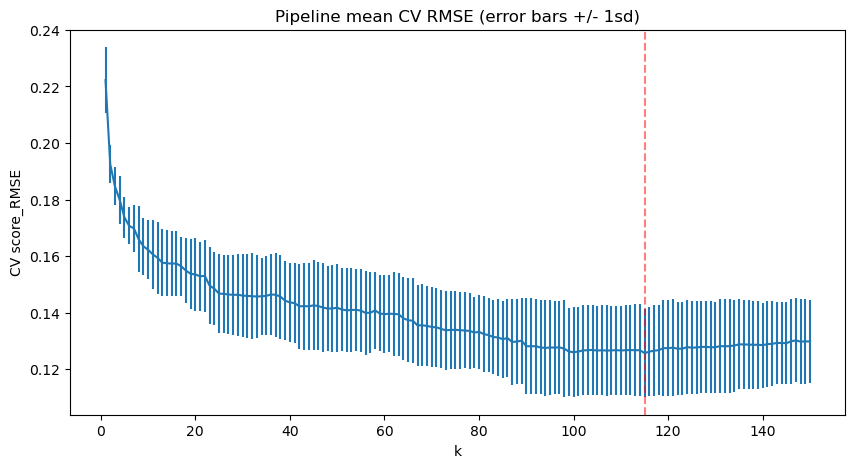

In [304]:
# Assign the value of k from the above dict of 'best_params_' and assign it to 'best_k'
plt.subplots(figsize=(10, 5))
plt.errorbar(cv_k, lr_grid_rmse_scores, yerr=lr_grid_rmse_std)
plt.axvline(x=lr_grid_best_k, c='r', ls='--', alpha=.5)
plt.xlabel('k')
plt.ylabel('CV score_RMSE')
plt.title('Pipeline mean CV RMSE (error bars +/- 1sd)')

In the r-squared plot against k, the CV score (r-squared) increases sharply for k<10k<10, followed by a more gradual rise until it plateaus around k≈80 with the mean r-squared of 0.8852. The red dashed line marks the highest mean R-squared value, but given the large error bars in the plateau region, the differences are not statistically significant. Consistently, the two loss-of-function metrics, MAE and RMSE, exhibit an inverse but similar trend to R-squared. Both MAE and RMSE decrease steeply for small k values and continue to decline at a slower rate before reaching a stable minimum, reinforcing the observed pattern in r-squared.

In [305]:
print(f'Best CV test score:{lr_grid_cv.best_score_:.4f}')

Best CV test score:0.8852


In [306]:
lr_grid_cv.best_params_

{'selectkbest__k': 115}

In [307]:
# Get the index of the best parameter set
lr_grid_best_index = lr_grid_cv.best_index_
print(lr_grid_best_index)

# Extract best R², MAE, and RMSE scores
lr_grid_best_r2 = lr_grid_cv.cv_results_['mean_test_r2'][lr_grid_best_index]
lr_grid_best_mae = -lr_grid_cv.cv_results_['mean_test_mae'][lr_grid_best_index]
lr_grid_best_rmse = -lr_grid_cv.cv_results_['mean_test_rmse'][lr_grid_best_index]

print(f'Best R² score:{lr_grid_best_r2:.4f}')
print(f'Best MAE score:{lr_grid_best_mae:.4f}')
print(f'Best RMSE score:{lr_grid_best_rmse:.4f}')

114
Best R² score:0.8852
Best MAE score:0.0829
Best RMSE score:0.1257


In [308]:
model_compare['lr_grid_bestk'] = [round(lr_grid_best_r2, 4), round(lr_grid_best_mae, 4), round(lr_grid_best_rmse, 4)]

Rank the selected features based on their model coefficients which reflect how much useful each feature is.

In [309]:
# Get a logical mask of the features selected.
selected = lr_grid_cv.best_estimator_.named_steps.selectkbest.get_support()

#get the matching feature names from the column names of the dataframe,
#and display the results as a pandas Series with `coefs` as the values and `features` as the index,
#sorting the values in descending order
coefs = lr_grid_cv.best_estimator_.named_steps.linearregression.coef_
features = X_tf_train.columns[selected]
pd.Series(coefs, index=features).sort_values(ascending=False).head(10)

OverallQual             0.393150
GrLivArea               0.276128
GarageCars              0.189571
Neighborhood_StoneBr    0.162514
Neighborhood_NridgHt    0.141937
SaleType_New            0.125386
Neighborhood_Crawfor    0.122885
Neighborhood_NoRidge    0.113129
1stFlrSF                0.094320
Neighborhood_Somerst    0.092927
dtype: float64

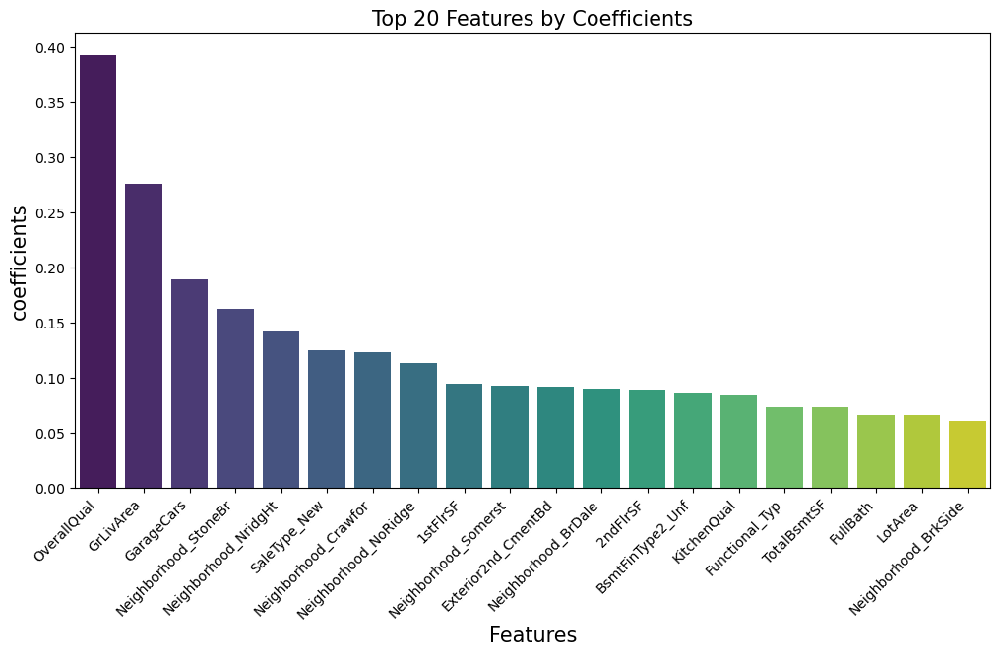

In [310]:
top_20_features = pd.Series(coefs, index=features).sort_values(ascending=False).head(20)
plt.figure(figsize=(12, 6))
sns.barplot(x=top_20_features.index, y=top_20_features.values, palette='viridis')
plt.xticks(rotation=45, ha='right')
plt.xlabel('Features',fontsize=15)
plt.ylabel('coefficients',fontsize=15)
plt.title('Top 20 Features by Coefficients',fontsize=15)
plt.show()

These results suggest that OverallQual is the most influential positive feature in predicting housing prices. Additionally, three capacity-related features—GrLivArea, GarageCars, and 1stFlrSF—rank among the top 10, aligning with expectations that larger living spaces and garage capacity contribute significantly to home value. Furthermore, five neighborhood-related features are also in the top 10, reinforcing the well-established impact of location on housing prices. Lastly, SaleType_New, which represents newly constructed and sold homes, ranks within the top 10, which is intuitively reasonable given that new homes tend to have higher market value.

#### 2.1.4 Optimizing the regularization strength in Ridge, Lasso, and ElasticNet using Optuna.

##### 2.1.4.1 Optimize Ridge Regression

Ridge regression introduces L2 regularization, it is a type of regularized linear regression that helps prevent overfitting by adding a penalty term to the model. This can improve the model’s generalization, especially if your data has multicollinearity (high correlation between independent variables). Use Ridge if you suspect multicollinearity but want to retain all features.

Why Use Ridge Regression?
1. **Reduces Overfitting** – Standard linear regression (OLS) can have high variance if features are highly correlated, leading to poor performance on new data.
2. **Better Coefficient Stability** – Ridge regression shrinks the coefficients toward zero, making the model more robust.
3. **Bias-Variance Tradeoff** – By adding a regularization term, Ridge regression balances between model complexity and performance.

alpha, the primary hyperparameter to optimize, controls regularization strength:

    Small alpha → behaves like normal linear regression.
    Large alpha → more penalty, leading to smaller coefficients.

In [311]:
import optuna
from sklearn.linear_model import Ridge

scoring = {
    'r2':'r2', 
    'mae': 'neg_mean_absolute_error', 
    'rmse': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False)
}

def objective_ridge(trial):
    alpha = trial.suggest_loguniform('alpha', 1e-4, 100)  # Search in log scale
    ridge_model = Ridge(alpha=alpha)

    # Perform cross-validation
    ridge_scores = cross_validate(ridge_model, X_tf_train, y_tf_train, cv=5, scoring=scoring, return_train_score=True)

    # Store metrics
    trial.set_user_attr('r2', ridge_scores['test_r2'].mean())
    trial.set_user_attr('mae', -ridge_scores['test_mae'].mean()) # Convert back to positive since scikit-learn returns negatives
    trial.set_user_attr('rmse', -ridge_scores['test_rmse'].mean()) # Convert back to positive
    
    return ridge_scores['test_r2'].mean() # Optimize only based on R2
    

ridge_study = optuna.create_study(direction='maximize')
ridge_study.optimize(objective_ridge, n_trials=50)

# Best parameters and best metrics
ridge_best_params = ridge_study.best_params
ridge_best_r2 = ridge_study.best_value
ridge_best_mae = ridge_study.best_trial.user_attrs['mae']
ridge_best_rmse = ridge_study.best_trial.user_attrs['rmse']

print("Best R²:", ridge_best_r2)
print("Best MAE:", ridge_best_mae)
print("Best RMSE:", ridge_best_rmse)
print("Best Parameters:", ridge_best_params)

[I 2025-04-03 00:19:13,643] A new study created in memory with name: no-name-5c74f63e-6647-47a8-b143-097d26fec7ca
[I 2025-04-03 00:19:13,758] Trial 0 finished with value: 0.8780025382187034 and parameters: {'alpha': 0.0008161282312399451}. Best is trial 0 with value: 0.8780025382187034.
[I 2025-04-03 00:19:13,827] Trial 1 finished with value: 0.8780052266875481 and parameters: {'alpha': 0.001003652742751203}. Best is trial 1 with value: 0.8780052266875481.
[I 2025-04-03 00:19:13,908] Trial 2 finished with value: 0.8855524576439983 and parameters: {'alpha': 2.148226024905646}. Best is trial 2 with value: 0.8855524576439983.
[I 2025-04-03 00:19:14,003] Trial 3 finished with value: 0.8789295773274052 and parameters: {'alpha': 0.07748392524086141}. Best is trial 2 with value: 0.8855524576439983.
[I 2025-04-03 00:19:14,119] Trial 4 finished with value: 0.864674847503412 and parameters: {'alpha': 78.34626443977062}. Best is trial 2 with value: 0.8855524576439983.
[I 2025-04-03 00:19:14,217] 

Best R²: 0.8871625931522479
Best MAE: 0.08037395473109855
Best RMSE: 0.12445133975460079
Best Parameters: {'alpha': 6.288286648187487}


Visualizes how R² scores improved over trials.

In [312]:
fig = vis.plot_optimization_history(ridge_study)
fig.show()

In [313]:
model_compare['ridge_bay_best'] = [round(ridge_best_r2, 4), round(ridge_best_mae, 4), round(ridge_best_rmse, 4)]

##### 2.1.4.2 Optimize Lasso Regression

Lasso (Least Absolute Shrinkage and Selection Operator) is another form of regularized linear regression, but unlike Ridge, it uses L1 regularization. This means it can shrink some coefficients exactly to zero, effectively selecting the most important features. Use Lasso if you want automatic feature selection and a more interpretable model.

Why Use Lasso Regression?
1. **Feature Selection** – Lasso automatically removes irrelevant features by setting their coefficients to zero.
2. **Reduces Overfitting** – Like Ridge, Lasso helps generalization by penalizing large coefficients.
3. **Improves Interpretability** – Since it selects only a subset of features, the final model is simpler.

In [314]:
from sklearn.linear_model import Lasso

def objective_lasso(trial):
    alpha = trial.suggest_loguniform('alpha', 1e-4, 100) # Search in log scale
    lasso_model = Lasso(alpha=alpha, max_iter=5000)

     # Perform cross-validation
    lasso_scores = cross_validate(lasso_model, X_tf_train, y_tf_train, cv=5, scoring=scoring, return_train_score=True)

    # Store metrics
    trial.set_user_attr('r2', lasso_scores['test_r2'].mean())
    trial.set_user_attr('mae', -lasso_scores['test_mae'].mean()) # Convert back to positive since scikit-learn returns negatives
    trial.set_user_attr('rmse', -lasso_scores['test_rmse'].mean()) # Convert back to positive
    
    return lasso_scores['test_r2'].mean() # Optimize only based on R2

lasso_study = optuna.create_study(direction='maximize')
lasso_study.optimize(objective_lasso, n_trials=50)

# Best parameters and best metrics
lasso_best_params = lasso_study.best_params
lasso_best_r2 = lasso_study.best_value
lasso_best_mae = lasso_study.best_trial.user_attrs['mae']
lasso_best_rmse = lasso_study.best_trial.user_attrs['rmse']

print("Best R²:", lasso_best_r2)
print("Best MAE:", lasso_best_mae)
print("Best RMSE:", lasso_best_rmse)
print("Best Parameters:", lasso_best_params)

[I 2025-04-03 00:19:17,939] A new study created in memory with name: no-name-7cf021a2-44dc-4ca9-a060-2f3e349c1cb0
[I 2025-04-03 00:19:18,169] Trial 0 finished with value: 0.8873435951173626 and parameters: {'alpha': 0.00017297636458721305}. Best is trial 0 with value: 0.8873435951173626.
[I 2025-04-03 00:19:18,387] Trial 1 finished with value: 0.8861189018253682 and parameters: {'alpha': 0.00013283106246512238}. Best is trial 0 with value: 0.8873435951173626.
[I 2025-04-03 00:19:18,462] Trial 2 finished with value: 0.39007394345233115 and parameters: {'alpha': 0.4277307468678439}. Best is trial 0 with value: 0.8873435951173626.
[I 2025-04-03 00:19:18,539] Trial 3 finished with value: -0.0032692697413028602 and parameters: {'alpha': 53.49645235835451}. Best is trial 0 with value: 0.8873435951173626.
[I 2025-04-03 00:19:18,617] Trial 4 finished with value: 0.4102427840652213 and parameters: {'alpha': 0.14648865509062303}. Best is trial 0 with value: 0.8873435951173626.
[I 2025-04-03 00:1

Best R²: 0.892064392907411
Best MAE: 0.07814003019237492
Best RMSE: 0.12162509360168858
Best Parameters: {'alpha': 0.0006711354085692404}


Visualizes how R² scores improved over trials.

In [315]:
fig = vis.plot_optimization_history(lasso_study)
fig.show()

In [316]:
model_compare['lasso_bay_best'] = [round(lasso_best_r2, 4), round(lasso_best_mae, 4), round(lasso_best_rmse, 4)]

##### 2.1.4.3 Optimize ElasticNet

ElasticNet combines L1 (Lasso) and L2 (Ridge) regularization, allowing you to benefit from both feature selection and coefficient shrinkage. It is particularly useful when:

    You suspect some features are irrelevant (like Lasso).
    You have high multicollinearity (like Ridge).
    You want to balance between Ridge and Lasso instead of choosing one.

ElasticNet has two key hyperparameters:

    alpha → Overall regularization strength (like in Ridge & Lasso).
    l1_ratio → Defines how much of the penalty is L1 vs. L2:
    
        l1_ratio = 1.0 → Pure Lasso (only L1 regularization).
        l1_ratio = 0.0 → Pure Ridge (only L2 regularization).
        l1_ratio = 0.5 → Balanced mix of Ridge and Lasso.

In [317]:
from sklearn.linear_model import ElasticNet

def objective_elastic(trial):
    alpha = trial.suggest_loguniform('alpha', 1e-4, 100)
    l1_ratio = trial.suggest_uniform('l1_ratio', 0, 1)  # Mix of Ridge & Lasso
    elastic_model = ElasticNet(alpha=alpha, l1_ratio=l1_ratio, max_iter=5000)        
    
     # Perform cross-validation
    elastic_scores = cross_validate(elastic_model, X_tf_train, y_tf_train, cv=5, scoring=scoring, return_train_score=True)

    # Store metrics
    trial.set_user_attr('r2', elastic_scores['test_r2'].mean())
    trial.set_user_attr('mae', -elastic_scores['test_mae'].mean()) # Convert back to positive since scikit-learn returns negatives
    trial.set_user_attr('rmse', -elastic_scores['test_rmse'].mean()) # Convert back to positive
    
    return elastic_scores['test_r2'].mean() # Optimize only based on R2


elastic_study = optuna.create_study(direction='maximize')
elastic_study.optimize(objective_elastic, n_trials=50)

# Best parameters and best metrics
elastic_best_params = elastic_study.best_params
elastic_best_r2 = elastic_study.best_value
elastic_best_mae = elastic_study.best_trial.user_attrs['mae']
elastic_best_rmse = elastic_study.best_trial.user_attrs['rmse']

print("Best R²:", elastic_best_r2)
print("Best MAE:", elastic_best_mae)
print("Best RMSE:", elastic_best_rmse)
print("Best Parameters:", elastic_best_params)

model_compare['elastic_bay_best'] = [round(elastic_best_r2, 4), round(elastic_best_mae, 4), round(elastic_best_rmse, 4)]


[I 2025-04-03 00:19:23,473] A new study created in memory with name: no-name-a0822ed1-1caa-4f80-a5a7-7fe3ab407d42
[I 2025-04-03 00:19:23,557] Trial 0 finished with value: 0.8572559290721076 and parameters: {'alpha': 0.005280000651172044, 'l1_ratio': 0.7949589446164925}. Best is trial 0 with value: 0.8572559290721076.
[I 2025-04-03 00:19:23,674] Trial 1 finished with value: 0.8901632355407914 and parameters: {'alpha': 0.000444100018416407, 'l1_ratio': 0.737650368000063}. Best is trial 1 with value: 0.8901632355407914.
[I 2025-04-03 00:19:23,739] Trial 2 finished with value: -0.0032692697413028602 and parameters: {'alpha': 97.45916079561552, 'l1_ratio': 0.38265188456067367}. Best is trial 1 with value: 0.8901632355407914.
[I 2025-04-03 00:19:23,897] Trial 3 finished with value: 0.8872001101689273 and parameters: {'alpha': 0.00016898327372897025, 'l1_ratio': 0.9917683726974469}. Best is trial 1 with value: 0.8901632355407914.
[I 2025-04-03 00:19:23,974] Trial 4 finished with value: 0.7657

Best R²: 0.8920604379889798
Best MAE: 0.07820955583197911
Best RMSE: 0.12161543224279012
Best Parameters: {'alpha': 0.0007845691026287492, 'l1_ratio': 0.7473106713262895}


Shows which hyperparameters had the biggest impact on model performance.

In [318]:
import optuna.visualization as vis

fig = vis.plot_param_importances(elastic_study)
fig.show()

Displays how alpha and l1_ratio (for ElasticNet) affect performance.

In [319]:
fig = vis.plot_contour(elastic_study, params=['alpha', 'l1_ratio'])
fig.show()

Visualizes how R² scores improved over trials.

In [320]:
fig = vis.plot_optimization_history(elastic_study)
fig.show()

### 2.2 Random Forest Model

#### 2.2.1 Random Forest: Default Hyperparameters & Cross-Validation

In [321]:
# Define RandomForestRegressor
rf = RandomForestRegressor(random_state=47)

# Define scoring
scoring = {
    'r2':'r2', 
    'mae': 'neg_mean_absolute_error', 
    'rmse': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False)
}

# Call 'cross_validate' to estimate the model performance
# Pass it the random forest regressor object, 'X_tf_train' and 'y_tf_train', 
# and get it to use 5-fold cross-validation
rf_default_cv_results = cross_validate(rf, X_tf_train, y_tf_train, cv=5, scoring=scoring, return_train_score=True)

In [322]:
print(rf_default_cv_results.keys())

dict_keys(['fit_time', 'score_time', 'test_r2', 'train_r2', 'test_mae', 'train_mae', 'test_rmse', 'train_rmse'])


In [323]:
rf_default_cv_r2 = rf_default_cv_results['test_r2']
rf_default_cv_mae = -rf_default_cv_results['test_mae']
rf_default_cv_rmse = -rf_default_cv_results['test_rmse']

print(f"R² Scores: {rf_default_cv_r2}")
print(f"Mean R²: {np.mean(rf_default_cv_r2):.4f}")
print(f"MAE Scores: {rf_default_cv_mae}")
print(f"Mean MAE: {np.mean(rf_default_cv_mae):.4f}")
print(f"RMSE Scores: {rf_default_cv_rmse}")
print(f"Mean RMSE: {np.mean(rf_default_cv_rmse):.4f}")

R² Scores: [0.86043462 0.86287023 0.86076368 0.88957064 0.84132646]
Mean R²: 0.8630
MAE Scores: [0.09452107 0.09590423 0.09188766 0.08995896 0.09532782]
Mean MAE: 0.0935
RMSE Scores: [0.13808446 0.14685044 0.14225576 0.12593333 0.1409182 ]
Mean RMSE: 0.1388


In [324]:
model_compare['rf_cv_default'] = [round(np.mean(rf_default_cv_r2), 4), round(np.mean(rf_default_cv_mae), 4), round(np.mean(rf_default_cv_rmse), 4)]

#### 2.2.2 Random Forest: Initial hyperparameter search using GridSearchCV

In [325]:
# Generates 20 numbers logarithmically spaced between 10**1 (10) and 10**3 (1000)
n_est = [int(n) for n in np.logspace(start=1, stop=3, num=20)]
grid_params = {'n_estimators': n_est}

# Define scoring metrics
scoring = {
    'r2':'r2', 
    'mae': 'neg_mean_absolute_error', 
    'rmse': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False)
}
# Call `GridSearchCV` with the random forest, passing in the above `grid_params`
#dict for parameters to evaluate, 5-fold cross-validation, and all available CPU cores
rf_grid_nest = GridSearchCV(rf, param_grid=grid_params, cv=5, n_jobs=-1, scoring=scoring, refit='r2')

In [326]:
#Now call the `GridSearchCV`'s `fit()` method with `X_tf_train` and `y_tf_train` as arguments
#to actually start the grid search.
rf_grid_nest.fit(X_tf_train, y_tf_train)

GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=47), n_jobs=-1,
             param_grid={'n_estimators': [10, 12, 16, 20, 26, 33, 42, 54, 69,
                                          88, 112, 143, 183, 233, 297, 379, 483,
                                          615, 784, 1000]},
             refit='r2',
             scoring={'mae': 'neg_mean_absolute_error', 'r2': 'r2',
                      'rmse': make_scorer(<lambda>, greater_is_better=False, response_method='predict')})

In [327]:
rf_grid_nest.best_params_

{'n_estimators': 1000}

In [328]:
rf_best_nest = cross_validate(rf_grid_nest.best_estimator_, X_tf_train, y_tf_train, cv=5, scoring=scoring, return_train_score=True)
rf_bestnest_r2 = rf_best_nest['test_r2']
rf_bestnest_mae = -rf_best_nest['test_mae']
rf_bestnest_rmse = -rf_best_nest['test_rmse']

print(f"R² Scores: {rf_bestnest_r2}")
print(f"Mean R²: {np.mean(rf_bestnest_r2):.4f}")
print(f"MAE Scores: {rf_bestnest_mae}")
print(f"Mean MAE: {np.mean(rf_bestnest_mae):.4f}")
print(f"RMSE Scores: {rf_bestnest_rmse}")
print(f"Mean RMSE: {np.mean(rf_bestnest_rmse):.4f}")

R² Scores: [0.86335    0.86468325 0.86367315 0.8883735  0.84222026]
Mean R²: 0.8645
MAE Scores: [0.09298976 0.09528062 0.09120091 0.08939801 0.09419425]
Mean MAE: 0.0926
RMSE Scores: [0.13663463 0.14587644 0.14076163 0.1266141  0.14052075]
Mean RMSE: 0.1381


In [329]:
model_compare['rf_grid_best_nest'] = [round(np.mean(rf_bestnest_r2), 4), round(np.mean(rf_bestnest_mae), 4), round(np.mean(rf_bestnest_rmse), 4)]

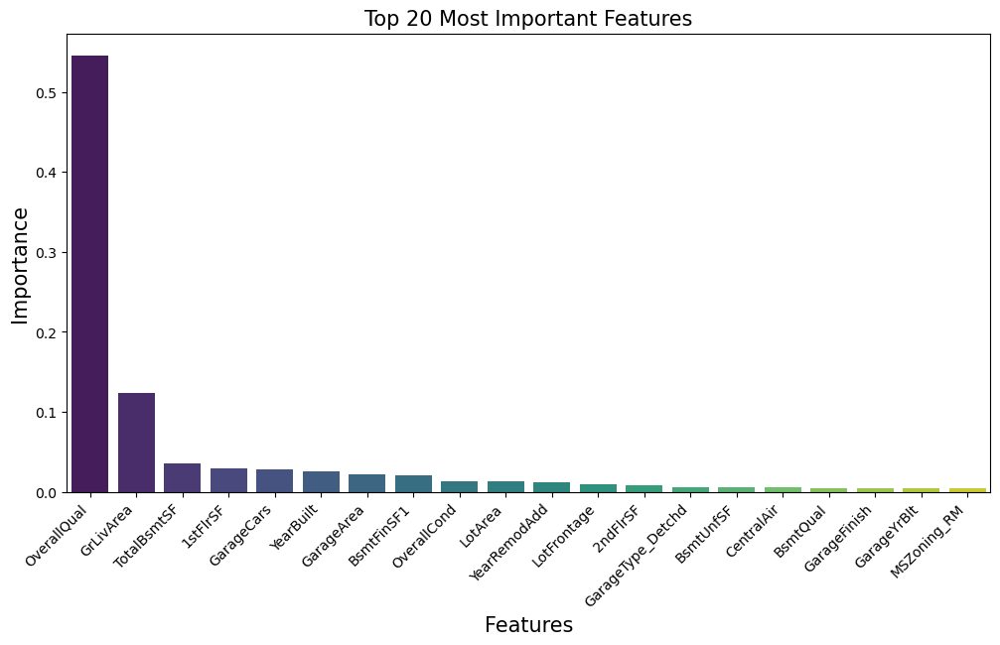

In [330]:
#Plot a barplot of the random forest's feature importances
plt.subplots(figsize=(12, 6))
imps = rf_grid_nest.best_estimator_.feature_importances_
rf_feat_imps = pd.Series(imps, index=X_tf_train.columns).sort_values(ascending=False).head(20)
sns.barplot(x=rf_feat_imps.index, y=rf_feat_imps.values, palette='viridis')
plt.xlabel('Features', fontsize=15)
plt.ylabel('Importance',fontsize=15)
plt.xticks(rotation=45, ha='right')
plt.title('Top 20 Most Important Features',fontsize=15)
plt.show()

In [331]:
pd.Series(imps, index=X_tf_train.columns).sort_values(ascending=False).head(10)

OverallQual    0.545857
GrLivArea      0.123554
TotalBsmtSF    0.035852
1stFlrSF       0.029599
GarageCars     0.027692
YearBuilt      0.025200
GarageArea     0.021456
BsmtFinSF1     0.020387
OverallCond    0.013595
LotArea        0.012472
dtype: float64

By comparing the top 10 features from the linear regression model (coefficients) and the random forest model (feature importances), we can derive the following insights: 
1. OverallQual is the most important feature in both models, confirming its strong influence on housing prices.
2. Linear regression emphasizes categorical features (e.g., neighborhoods, sale type), while random forest prioritizes numerical structural attributes (e.g., TotalBsmtSF, YearBuilt, LotArea).
3. GrLivArea and GarageCars are important in both models but ranked differently, indicating differences in how linear and non-linear models interpret their impact.
4. Random forest captures complex interactions and non-linear relationships better, while linear regression highlights direct linear effects.

#### 2.2.3 Random Forest: Comprehensive hyperparameter search using RandomizedSearchCV

In [332]:
# Generates distionary containing the range of each hyperparameter for searching
params_dist = {
    'n_estimators': randint(50, 1000), # More trees can improve performance but also increase computation time
    'max_depth': [None, 10, 20, 30, 50], # Maximum depth of each tree, None means nodes are expanded until all leaves are pure or contain min_samples_split samples
    'min_samples_split': randint(2, 20), # Minimum number of samples required to split an internal node, Higher values prevent overfitting
    'min_samples_leaf': randint(1, 10), # Minimum number of samples required at a leaf node, Larger values smooth the model and reduce overfitting
    'max_features': ['auto', 'sqrt', 'log2', None], # Number of features to consider for splitting
    'bootstrap': [True, False], # Whether bootstrap samples are used when building trees
    }

# Define scoring metrics
scoring = {
    'r2':'r2', 
    'mae': 'neg_mean_absolute_error', 
    'rmse': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False)
}
# Call `GridSearchCV` with the random forest, passing in the above `grid_params`
#dict for parameters to evaluate, 5-fold cross-validation, and all available CPU cores
rf_rand_search = RandomizedSearchCV(rf, param_distributions=params_dist, n_iter=20, cv=5, n_jobs=-1, scoring=scoring, refit='r2', verbose=2, random_state=42)
rf_rand_search.fit(X_tf_train, y_tf_train)

Fitting 5 folds for each of 20 candidates, totalling 100 fits


RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(random_state=47),
                   n_iter=20, n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [None, 10, 20, 30, 50],
                                        'max_features': ['auto', 'sqrt', 'log2',
                                                         None],
                                        'min_samples_leaf': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x000002CAD00DBEF0>,
                                        'min_samples_split': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x000002CADF197860>,
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x000002CABAA616A0>},
                   random_state=42, refit='r2',
                   scoring={'mae': 'neg_mean_absolute_error', 'r2': 'r2',
                            'rmse': make_scorer(<lambda>, greater_is_better=False, response_method='predict')},
                   verbose=2)

In [333]:
# Best estimator (model with best hyperparameters)
rf_rand_best = rf_rand_search.best_estimator_

# Get the cross_validation results
rf_rand_cv_results = rf_rand_search.cv_results_

# Extract the best R2, MAE, and RMSE
rf_rand_best_r2 = rf_rand_search.best_score_
rf_rand_best_index = rf_rand_search.best_index_

rf_rand_best_mae = -rf_rand_cv_results['mean_test_mae'][rf_rand_best_index]
rf_rand_best_rmse = -rf_rand_cv_results['mean_test_rmse'][rf_rand_best_index]

# Print results
print("Best Hyperparameters:", rf_rand_search.best_params_)
print('Best R2 Score:{:.4f}', format(rf_rand_best_r2))
print('Best MAE: {:.4f}', format(rf_rand_best_mae))
print('Best RMSE: {:.4f}', format(rf_rand_best_rmse))

model_compare['rf_rand_best'] = [round(rf_rand_best_r2,4), round(rf_rand_best_mae,4), round(rf_rand_best_rmse,4)]



Best Hyperparameters: {'bootstrap': True, 'max_depth': 10, 'max_features': None, 'min_samples_leaf': 3, 'min_samples_split': 13, 'n_estimators': 616}
Best R2 Score:{:.4f} 0.8577040340377721
Best MAE: {:.4f} 0.09500481484226078
Best RMSE: {:.4f} 0.1413917029546391


#### 2.2.4 Random Forest: Comprehensive hyperparameter search using Bayesian Optimization

In Bayesian optimization using Optuna, return multiple evaluation metrics (r2, mae, and rmse) while optimizing the model based solely on r2.

In [334]:
# Define scoring metrics
scoring = {
    'r2':'r2', 
    'mae': 'neg_mean_absolute_error', 
    'rmse': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False)
}

def objective_rf1(trial):

    # Suggest values for hyperparameters
    n_estimators = trial.suggest_int('n_estimators', 50, 1000) # More trees can improve performance but also increase computation time
    max_depth = trial.suggest_categorical('max_depth', [None, 10, 20, 30, 50]) # Maximum depth of each tree, None means nodes are expanded until all leaves are pure or contain min_samples_split samples
    min_samples_split = trial.suggest_int('min_samples_split', 2, 20) # Minimum number of samples required to split an internal node, Higher values prevent overfitting
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 10) # Minimum number of samples required at a leaf node, Larger values smooth the model and reduce overfitting
    max_features = trial.suggest_categorical('max_features', ['sqrt', 'log2', None]) # Number of features to consider for splitting
    bootstrap = trial.suggest_categorical('bootstrap', [True, False]) # Whether bootstrap samples are used when building trees

    # Define model
    rf = RandomForestRegressor(
        n_estimators=n_estimators, 
        max_depth=max_depth, 
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        max_features=max_features,
        bootstrap=bootstrap, 
        random_state=47
        )
              
    # perform cross-validation
    scores = cross_validate(rf, X_tf_train, y_tf_train, cv=5, scoring=scoring, return_train_score=True)

    # Store metrics
    trial.set_user_attr('r2', scores['test_r2'].mean())
    trial.set_user_attr('mae', -scores['test_mae'].mean()) # Convert back to positive since scikit-learn returns negatives
    trial.set_user_attr('rmse', -scores['test_rmse'].mean()) # Convert back to positive
    

    return scores['test_r2'].mean() # Optimize only based on R2

# Run the optimization
rf1_study = optuna.create_study(direction='maximize') # Maximize R2
rf1_study.optimize(objective_rf1, n_trials=20)

# Retrieve the best parameters and store the three metrics into model_compare dict
rf1_best_trial = rf1_study.best_trial
print('Best parameters:', rf1_best_trial.params)
print('Best R² Score:', rf1_best_trial.value)
print('Corresponding MAE:', rf1_best_trial.user_attrs["mae"])
print('Corresponding RMSE:', rf1_best_trial.user_attrs["rmse"])


[I 2025-04-03 00:25:14,317] A new study created in memory with name: no-name-913e790c-0d79-4d4a-a2b3-6973836eda71
[I 2025-04-03 00:26:58,988] Trial 0 finished with value: 0.7414892378870721 and parameters: {'n_estimators': 978, 'max_depth': None, 'min_samples_split': 5, 'min_samples_leaf': 3, 'max_features': None, 'bootstrap': False}. Best is trial 0 with value: 0.7414892378870721.
[I 2025-04-03 00:27:04,921] Trial 1 finished with value: 0.8278527180804145 and parameters: {'n_estimators': 576, 'max_depth': 20, 'min_samples_split': 19, 'min_samples_leaf': 9, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 1 with value: 0.8278527180804145.
[I 2025-04-03 00:27:08,646] Trial 2 finished with value: 0.8353824062294176 and parameters: {'n_estimators': 364, 'max_depth': 20, 'min_samples_split': 10, 'min_samples_leaf': 3, 'max_features': 'log2', 'bootstrap': True}. Best is trial 2 with value: 0.8353824062294176.
[I 2025-04-03 00:27:11,820] Trial 3 finished with value: 0.83229211651708

Best parameters: {'n_estimators': 658, 'max_depth': 50, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': None, 'bootstrap': True}
Best R² Score: 0.8640406310084507
Corresponding MAE: 0.09240904618753525
Corresponding RMSE: 0.13822458600749757


Visualizes how R² scores improved over trials.

In [335]:
fig = vis.plot_optimization_history(rf1_study)
fig.show()

Shows which hyperparameters had the biggest impact on model performance.

In [336]:
import optuna.visualization as vis

fig = vis.plot_param_importances(rf1_study)
fig.show()

In [337]:
model_compare['rf_Bay_best'] = [round(rf1_best_trial.user_attrs["r2"], 4), 
                                  round(rf1_best_trial.user_attrs['mae'], 4),
                                  round(rf1_best_trial.user_attrs['rmse'], 4)
                                  ]

#### 2.2.5 Random Forest with unscaled training dataset: Comprehensive hyperparameter search using Bayesian Optimization

For Random Forest alone, feature scaling is unnecessary and typically does not improve performance. However, I plan to run a new Random Forest model using Bayesian optimization with unscaled data, except for the month feature, as the sin-cos transformation may help the model recognize seasonal cycles.

In [338]:
# Load datasets 
df_train = pd.read_csv('df_train_EDA.csv')
df_test = pd.read_csv('df_test_EDA.csv')

# Identify numeric features
numeric_features = df_train.select_dtypes(include=['int64', 'float64']).columns.tolist()
categorical_features = df_train.select_dtypes(include=['object', 'category']).columns.tolist()

print(f'Total numeric features in training dataset: {len(numeric_features)}')
print(f'Total categorical features in training dataset: {len(categorical_features)}')
print(f'Total features in training dataset: {len(df_train.columns.tolist())}')


Total numeric features in training dataset: 151
Total categorical features in training dataset: 0
Total features in training dataset: 151


Apply sin-cos transformation to MoSold and update DataFrames

In [339]:
def sin_cos_transform(df, col):
    return df.assign(
        **{
            f"{col}_sin": np.sin(2 * np.pi * df[col] / 12),
            f"{col}_cos": np.cos(2 * np.pi * df[col] / 12)
            }
            ).drop(columns=[col])

# Apply to train and test data
df_train_rf = sin_cos_transform(df_train, 'MoSold')
df_test_rf = sin_cos_transform(df_test, 'MoSold')

In [340]:
X_train_rf = df_train_rf.drop(columns='SalePrice')
y_train_rf = df_train_rf['SalePrice']

In [341]:
# Define scoring metrics

def objective_rf2(trial):

    # Suggest values for hyperparameters
    n_estimators = trial.suggest_int('n_estimators', 50, 1000) # More trees can improve performance but also increase computation time
    max_depth = trial.suggest_categorical('max_depth', [None, 10, 20, 30, 50]) # Maximum depth of each tree, None means nodes are expanded until all leaves are pure or contain min_samples_split samples
    min_samples_split = trial.suggest_int('min_samples_split', 2, 20) # Minimum number of samples required to split an internal node, Higher values prevent overfitting
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 10) # Minimum number of samples required at a leaf node, Larger values smooth the model and reduce overfitting
    max_features = trial.suggest_categorical('max_features', ['sqrt', 'log2', None]) # Number of features to consider for splitting
    bootstrap = trial.suggest_categorical('bootstrap', [True, False]) # Whether bootstrap samples are used when building trees

    # Define model
    rf = RandomForestRegressor(
        n_estimators=n_estimators, 
        max_depth=max_depth, 
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        max_features=max_features,
        bootstrap=bootstrap, 
        random_state=47
        )
              
    # perform cross-validation
    scores = cross_validate(rf, X_train_rf, y_train_rf, cv=5, scoring=scoring, return_train_score=True)

    # Store metrics
    trial.set_user_attr('r2', scores['test_r2'].mean())
    trial.set_user_attr('mae', -scores['test_mae'].mean()) # Convert back to positive since scikit-learn returns negatives
    trial.set_user_attr('rmse', -scores['test_rmse'].mean()) # Convert back to positive
    

    return scores['test_r2'].mean() # Optimize only based on R2

# Run the optimization
rf2_study = optuna.create_study(direction='maximize') # Maximize R2
rf2_study.optimize(objective_rf2, n_trials=20)

# Retrieve the best parameters and store the three metrics into model_compare dict
rf2_best_trial = rf2_study.best_trial
print('Best parameters:', rf2_best_trial.params)
print('Best R² Score:', rf2_best_trial.value)
print('Corresponding MAE:', rf2_best_trial.user_attrs["mae"])
print('Corresponding RMSE:', rf2_best_trial.user_attrs["rmse"])


[I 2025-04-03 00:31:31,829] A new study created in memory with name: no-name-464c0036-31d5-48d7-b7e4-859d201c3cb4
[I 2025-04-03 00:31:41,987] Trial 0 finished with value: 0.8350918408139073 and parameters: {'n_estimators': 870, 'max_depth': 50, 'min_samples_split': 8, 'min_samples_leaf': 1, 'max_features': 'log2', 'bootstrap': True}. Best is trial 0 with value: 0.8350918408139073.
[I 2025-04-03 00:33:13,896] Trial 1 finished with value: 0.7108048638344427 and parameters: {'n_estimators': 953, 'max_depth': 20, 'min_samples_split': 10, 'min_samples_leaf': 5, 'max_features': None, 'bootstrap': False}. Best is trial 0 with value: 0.8350918408139073.
[I 2025-04-03 00:33:23,370] Trial 2 finished with value: 0.8083958491752297 and parameters: {'n_estimators': 898, 'max_depth': 30, 'min_samples_split': 19, 'min_samples_leaf': 8, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 0 with value: 0.8350918408139073.
[I 2025-04-03 00:33:26,886] Trial 3 finished with value: 0.8270674008749376

Best parameters: {'n_estimators': 773, 'max_depth': 10, 'min_samples_split': 7, 'min_samples_leaf': 2, 'max_features': 'sqrt', 'bootstrap': False}
Best R² Score: 0.8535067414206718
Corresponding MAE: 17502.886694590237
Corresponding RMSE: 30053.796162190898


Shows which hyperparameters had the biggest impact on model performance.

In [342]:
import optuna.visualization as vis

fig = vis.plot_param_importances(rf2_study)
fig.show()


Visualizes how R² scores improved over trials.

In [343]:
fig = vis.plot_optimization_history(rf2_study)
fig.show()

In [344]:
model_compare['rf_unscale_Bay_best'] = [round(rf2_best_trial.user_attrs["r2"], 4), 
                                  round(rf2_best_trial.user_attrs['mae'], 4),
                                  round(rf2_best_trial.user_attrs['rmse'], 4)
                                  ]

In [345]:
model_compare

{'lr_outfit_training(reference_only)': [0.9223, 0.0704, 0.105],
 'lr_cv_default': [0.878, 0.085, 0.1298],
 'lr_grid_bestk': [0.8852, 0.0829, 0.1257],
 'ridge_bay_best': [0.8872, 0.0804, 0.1245],
 'lasso_bay_best': [0.8921, 0.0781, 0.1216],
 'elastic_bay_best': [0.8921, 0.0782, 0.1216],
 'rf_cv_default': [0.863, 0.0935, 0.1388],
 'rf_grid_best_nest': [0.8645, 0.0926, 0.1381],
 'rf_rand_best': [0.8577, 0.095, 0.1414],
 'rf_Bay_best': [0.864, 0.0924, 0.1382],
 'rf_unscale_Bay_best': [0.8535, 17502.8867, 30053.7962]}

In [346]:
model_compare_df = pd.DataFrame.from_dict(model_compare, orient='index')
model_compare_df.columns = ['R²', 'MAE', 'RMSE']
model_compare_df = model_compare_df.reset_index()
model_compare_df = model_compare_df.rename(columns={'index': 'Model'})
model_compare_df

,Model,R²,MAE,RMSE
0,lr_outfit_training(reference_only),0.9223,0.0704,0.1050
1,lr_cv_default,0.8780,0.0850,0.1298
2,lr_grid_bestk,0.8852,0.0829,0.1257
3,ridge_bay_best,0.8872,0.0804,0.1245
4,lasso_bay_best,0.8921,0.0781,0.1216
5,elastic_bay_best,0.8921,0.0782,0.1216
6,rf_cv_default,0.8630,0.0935,0.1388
7,rf_grid_best_nest,0.8645,0.0926,0.1381
8,rf_rand_best,0.8577,0.0950,0.1414
9,rf_Bay_best,0.8640,0.0924,0.1382


In [347]:
model_compare_df.sort_values(by='R²', ascending=False)

,Model,R²,MAE,RMSE
0,lr_outfit_training(reference_only),0.9223,0.0704,0.1050
4,lasso_bay_best,0.8921,0.0781,0.1216
5,elastic_bay_best,0.8921,0.0782,0.1216
3,ridge_bay_best,0.8872,0.0804,0.1245
2,lr_grid_bestk,0.8852,0.0829,0.1257
1,lr_cv_default,0.8780,0.0850,0.1298
7,rf_grid_best_nest,0.8645,0.0926,0.1381
9,rf_Bay_best,0.8640,0.0924,0.1382
6,rf_cv_default,0.8630,0.0935,0.1388
8,rf_rand_best,0.8577,0.0950,0.1414


This dataframe compares the performance of different models based on R² (coefficient of determination), MAE (Mean Absolute Error), and RMSE (Root Mean Squared Error).
Summary:
1. Linear regression models outperform random forest models in this case.
2. rf_Bay_best is the best random forest model, but still behind lr_grid_bestk.
3. Further fine-tuning may improve Random Forest performance.

### 2.3 LightGBM (Light Gradient Boosting Model)

[LightGBM](https://lightgbm.readthedocs.io/en/latest/) is a gradient boosting framework that uses tree-based learning algorithms. It is designed to be distributed and efficient with the following advantages:
* Faster training speed and higher efficiency.
* Lower memory usage.
* Better accuracy.
* Support of parallel and GPU learning.
* Capable of handling large-scale data.

Steps to configure Optuna for optimizing LightGBM hyperparameters with tracking of R², MAE, and RMSE metrics:
1. Define the objective function that LightGBM will optimize.
2. Use Optuna's Trial object to suggest hyperparameters.
3. Train the LightGBM model and evaluate it using cross-validation.
4. Return R² as the main optimization metric while logging MAE and RMSE.

#### 2.3.1 LightGBM: Comprehensive hyperparameter search using Bayesian Optimization

In [348]:
# Define Optina's objective function
def objective_lgb1(trial):
    # Hyperparameter search space
    params = {
        'objective': 'regression',
        'metric': 'rmse',
        'boosting_type': 'gbdt',
        "n_estimators": trial.suggest_int("n_estimators", 100, 1000),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),
        "num_leaves": trial.suggest_int("num_leaves", 10, 100),
        "max_depth": trial.suggest_int("max_depth", 3, 12),
        "min_child_samples": trial.suggest_int("min_child_samples", 5, 100),
        "subsample": trial.suggest_float("subsample", 0.5, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.5, 1.0),
        "reg_alpha": trial.suggest_float("reg_alpha", 1e-8, 10.0, log=True),
        "reg_lambda": trial.suggest_float("reg_lambda", 1e-8, 10.0, log=True),
    }

    # Create LightGBM regressor
    lgbm = lgb.LGBMRegressor(**params, random_state=42)

    # Perform cross-validation
    scores = cross_validate(lgbm, X_tf_train, y_tf_train, cv=5, scoring=scoring, return_train_score=True)

    # Store metrics
    trial.set_user_attr('r2', scores['test_r2'].mean())
    trial.set_user_attr('mae', -scores['test_mae'].mean()) # Convert back to positive since scikit-learn returns negatives
    trial.set_user_attr('rmse', -scores['test_rmse'].mean()) # Convert back to positive
    

    return scores['test_r2'].mean() # Optimize only based on R2

# Run Optuna optimization
lgb1_study = optuna.create_study(direction='maximize')
lgb1_study.optimize(objective_lgb1, n_trials=50)

# Best parameters and best metrics
lgb1_best_params = lgb1_study.best_params
lgb1_best_r2 = lgb1_study.best_value
lgb1_best_mae = lgb1_study.best_trial.user_attrs['mae']
lgb1_best_rmse = lgb1_study.best_trial.user_attrs['rmse']

print("Best R²:", lgb1_best_r2)
print("Best MAE:", lgb1_best_mae)
print("Best RMSE:", lgb1_best_rmse)
print("Best Parameters:", lgb1_best_params)

[I 2025-04-03 00:36:19,583] A new study created in memory with name: no-name-be324245-c0ad-4694-a7d7-6acc201ddc1f


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001698 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3013
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 72
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[I 2025-04-03 00:36:20,193] Trial 0 finished with value: 0.8629447236333881 and parameters: {'n_estimators': 407, 'learning_rate': 0.23112238227664228, 'num_leaves': 98, 'max_depth': 3, 'min_child_samples': 85, 'subsample': 0.7166111317239149, 'colsample_bytree': 0.8586725181671537, 'reg_alpha': 0.0007732183495123956, 'reg_lambda': 6.181203452825109e-06}. Best is trial 0 with value: 0.8629447236333881.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:20,844] Trial 1 finished with value: 0.8754623480825714 and parameters: {'n_estimators': 472, 'learning_rate': 0.07935717710470144, 'num_leaves': 10, 'max_depth': 8, 'min_child_samples': 74, 'subsample': 0.644736330808093, 'colsample_bytree': 0.9027418511235628, 'reg_alpha': 1.1388108662538383, 'reg_lambda': 0.0037219129020911877}. Best is trial 1 with value: 0.8754623480825714.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:23,136] Trial 2 finished with value: 0.8863525345852731 and parameters: {'n_estimators': 946, 'learning_rate': 0.04065680312980071, 'num_leaves': 40, 'max_depth': 7, 'min_child_samples': 46, 'subsample': 0.5269218361673453, 'colsample_bytree': 0.9950354057746704, 'reg_alpha': 3.254838322134994e-08, 'reg_lambda': 2.6510751394518878e-08}. Best is trial 2 with value: 0.8863525345852731.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:24,087] Trial 3 finished with value: 0.870522502198123 and parameters: {'n_estimators': 784, 'learning_rate': 0.05923642143626258, 'num_leaves': 100, 'max_depth': 3, 'min_child_samples': 96, 'subsample': 0.758319031193105, 'colsample_bytree': 0.9030262160494155, 'reg_alpha': 2.361255910304181e-05, 'reg_lambda': 0.10366489394590485}. Best is trial 2 with value: 0.8863525345852731.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:25,408] Trial 4 finished with value: 0.8766733913518309 and parameters: {'n_estimators': 639, 'learning_rate': 0.02689927493286281, 'num_leaves': 84, 'max_depth': 6, 'min_child_samples': 80, 'subsample': 0.7758584619280213, 'colsample_bytree': 0.8670975628807169, 'reg_alpha': 0.001864820408568491, 'reg_lambda': 0.0061449876204473595}. Best is trial 2 with value: 0.8863525345852731.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001443 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3013
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 72
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-04-03 00:36:26,273] Trial 5 finished with value: 0.873599907516344 and parameters: {'n_estimators': 354, 'learning_rate': 0.023384583203510084, 'num_leaves': 93, 'max_depth': 11, 'min_child_samples': 85, 'subsample': 0.8059530977416277, 'colsample_bytree': 0.8281702158499413, 'reg_alpha': 0.050826602460180705, 'reg_lambda': 0.00043377911497554506}. Best is trial 2 with value: 0.8863525345852731.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:27,753] Trial 6 finished with value: 0.873626662838852 and parameters: {'n_estimators': 661, 'learning_rate': 0.04290975484085984, 'num_leaves': 76, 'max_depth': 11, 'min_child_samples': 86, 'subsample': 0.5183105492026129, 'colsample_bytree': 0.9133732743517742, 'reg_alpha': 1.0192233851194858, 'reg_lambda': 4.67850860537377e-05}. Best is trial 2 with value: 0.8863525345852731.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:30,766] Trial 7 finished with value: 0.8879180664140696 and parameters: {'n_estimators': 878, 'learning_rate': 0.08304997265065707, 'num_leaves': 64, 'max_depth': 10, 'min_child_samples': 28, 'subsample': 0.98381948308246, 'colsample_bytree': 0.6278498252471936, 'reg_alpha': 0.0008129211837932741, 'reg_lambda': 0.0010463776420544689}. Best is trial 7 with value: 0.8879180664140696.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:31,615] Trial 8 finished with value: 0.8905056408836798 and parameters: {'n_estimators': 487, 'learning_rate': 0.07666851518521801, 'num_leaves': 93, 'max_depth': 3, 'min_child_samples': 42, 'subsample': 0.5696952836208082, 'colsample_bytree': 0.631014320520774, 'reg_alpha': 0.04846980329126466, 'reg_lambda': 4.776453935735155}. Best is trial 8 with value: 0.8905056408836798.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002514 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3074
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 98
[LightGBM] [Info] Start training from score 12.063630
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-04-03 00:36:34,110] Trial 9 finished with value: 0.8871574057832815 and parameters: {'n_estimators': 872, 'learning_rate': 0.040205773294879205, 'num_leaves': 98, 'max_depth': 9, 'min_child_samples': 47, 'subsample': 0.6906203437530043, 'colsample_bytree': 0.6273791388600519, 'reg_alpha': 4.217222635448299e-08, 'reg_lambda': 0.01790361069872176}. Best is trial 8 with value: 0.8905056408836798.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:34,757] Trial 10 finished with value: 0.8918180252674197 and parameters: {'n_estimators': 169, 'learning_rate': 0.1880073090773202, 'num_leaves': 45, 'max_depth': 5, 'min_child_samples': 12, 'subsample': 0.6032008562542328, 'colsample_bytree': 0.5052841323574397, 'reg_alpha': 4.786176461740404e-06, 'reg_lambda': 4.855016939549188}. Best is trial 10 with value: 0.8918180252674197.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001229 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3179
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 150
[LightGBM] [Info] Start training from score 12.063630
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-04-03 00:36:35,263] Trial 11 finished with value: 0.8918260640708218 and parameters: {'n_estimators': 125, 'learning_rate': 0.19522936811172142, 'num_leaves': 41, 'max_depth': 5, 'min_child_samples': 10, 'subsample': 0.608046968793164, 'colsample_bytree': 0.5051914811310497, 'reg_alpha': 6.871839331387618e-06, 'reg_lambda': 7.231664513735953}. Best is trial 11 with value: 0.8918260640708218.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001215 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3200
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 150
[LightGBM] [Info] Start training from score 12.071721
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-04-03 00:36:35,870] Trial 12 finished with value: 0.878766000754125 and parameters: {'n_estimators': 114, 'learning_rate': 0.28376157551358494, 'num_leaves': 41, 'max_depth': 5, 'min_child_samples': 7, 'subsample': 0.6140398950848329, 'colsample_bytree': 0.5007130946741267, 'reg_alpha': 3.2735794234392737e-06, 'reg_lambda': 8.158913864062447}. Best is trial 11 with value: 0.8918260640708218.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:36,525] Trial 13 finished with value: 0.8920383091789418 and parameters: {'n_estimators': 150, 'learning_rate': 0.13690225357562266, 'num_leaves': 35, 'max_depth': 5, 'min_child_samples': 6, 'subsample': 0.891145412268152, 'colsample_bytree': 0.5026299041955786, 'reg_alpha': 1.892707458615892e-06, 'reg_lambda': 0.38130575796338406}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:37,231] Trial 14 finished with value: 0.8891630341804829 and parameters: {'n_estimators': 234, 'learning_rate': 0.13389450144945075, 'num_leaves': 24, 'max_depth': 5, 'min_child_samples': 24, 'subsample': 0.8762146989221022, 'colsample_bytree': 0.5643033492416402, 'reg_alpha': 1.062760815943936e-06, 'reg_lambda': 0.2666148875125363}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:38,504] Trial 15 finished with value: 0.8753481102994206 and parameters: {'n_estimators': 256, 'learning_rate': 0.013181649658282705, 'num_leaves': 28, 'max_depth': 7, 'min_child_samples': 21, 'subsample': 0.8968085448489711, 'colsample_bytree': 0.713218625012857, 'reg_alpha': 4.3407880654155265e-05, 'reg_lambda': 0.28133766886630396}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000870 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3030
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 80
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-04-03 00:36:39,089] Trial 16 finished with value: 0.877577833631339 and parameters: {'n_estimators': 273, 'learning_rate': 0.1406638434875003, 'num_leaves': 58, 'max_depth': 4, 'min_child_samples': 66, 'subsample': 0.9700253679989406, 'colsample_bytree': 0.7111929835470148, 'reg_alpha': 1.2577582951975105e-07, 'reg_lambda': 0.6198519589836463}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Foun

[I 2025-04-03 00:36:39,683] Trial 17 finished with value: 0.8891180070473628 and parameters: {'n_estimators': 133, 'learning_rate': 0.13119754414318324, 'num_leaves': 27, 'max_depth': 6, 'min_child_samples': 35, 'subsample': 0.8825599548168765, 'colsample_bytree': 0.5512469200345764, 'reg_alpha': 5.063708658132609e-07, 'reg_lambda': 7.303486154882588e-08}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001549 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3097
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 109
[LightGBM] [Info] Start training from score 12.063630
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-04-03 00:36:40,796] Trial 18 finished with value: 0.8820601495915652 and parameters: {'n_estimators': 335, 'learning_rate': 0.17688687984676577, 'num_leaves': 11, 'max_depth': 6, 'min_child_samples': 5, 'subsample': 0.8467879699542735, 'colsample_bytree': 0.5719226612136055, 'reg_alpha': 5.9014994224214914e-05, 'reg_lambda': 0.048715954806194464}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000925 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3038
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 84
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-04-03 00:36:41,844] Trial 19 finished with value: 0.8769188223397834 and parameters: {'n_estimators': 599, 'learning_rate': 0.11241469656770131, 'num_leaves': 49, 'max_depth': 4, 'min_child_samples': 59, 'subsample': 0.9347320476452958, 'colsample_bytree': 0.7762343882340988, 'reg_alpha': 2.973966372137284e-07, 'reg_lambda': 3.2552935674046366e-06}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:42,824] Trial 20 finished with value: 0.8768375944822175 and parameters: {'n_estimators': 208, 'learning_rate': 0.24387197068476585, 'num_leaves': 34, 'max_depth': 8, 'min_child_samples': 18, 'subsample': 0.693846289812547, 'colsample_bytree': 0.6854809142525184, 'reg_alpha': 0.0067366301660346135, 'reg_lambda': 1.6616690439182324}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:43,265] Trial 21 finished with value: 0.8906507746722477 and parameters: {'n_estimators': 104, 'learning_rate': 0.18932837019666987, 'num_leaves': 48, 'max_depth': 5, 'min_child_samples': 13, 'subsample': 0.6166194921179053, 'colsample_bytree': 0.5134205223872667, 'reg_alpha': 4.825734612628213e-06, 'reg_lambda': 6.683950561328613}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001495 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3198
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 149
[LightGBM] [Info] Start training from score 12.071721
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-04-03 00:36:43,998] Trial 22 finished with value: 0.891380262054291 and parameters: {'n_estimators': 184, 'learning_rate': 0.17071857715522246, 'num_leaves': 65, 'max_depth': 4, 'min_child_samples': 11, 'subsample': 0.5833445821322558, 'colsample_bytree': 0.5373827357913965, 'reg_alpha': 7.160860203379299e-06, 'reg_lambda': 1.5608233833140994}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:44,829] Trial 23 finished with value: 0.8775632251150405 and parameters: {'n_estimators': 315, 'learning_rate': 0.2818720376610795, 'num_leaves': 49, 'max_depth': 5, 'min_child_samples': 32, 'subsample': 0.6564509430797154, 'colsample_bytree': 0.5968013053315792, 'reg_alpha': 4.8556780284402616e-05, 'reg_lambda': 9.871244309000494}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001551 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3103
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 112
[LightGBM] [Info] Start training from score 12.063630
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-04-03 00:36:45,653] Trial 24 finished with value: 0.8917302143487055 and parameters: {'n_estimators': 177, 'learning_rate': 0.11341388543561498, 'num_leaves': 36, 'max_depth': 6, 'min_child_samples': 17, 'subsample': 0.555834740800015, 'colsample_bytree': 0.5008325023914074, 'reg_alpha': 0.0001774622165601297, 'reg_lambda': 0.04635188554897999}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001917 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 138
[LightGBM] [Info] Start training from score 12.063630
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-04-03 00:36:46,522] Trial 25 finished with value: 0.8787442544459895 and parameters: {'n_estimators': 434, 'learning_rate': 0.1979968047463018, 'num_leaves': 19, 'max_depth': 4, 'min_child_samples': 37, 'subsample': 0.8126472781863657, 'colsample_bytree': 0.5922055445407215, 'reg_alpha': 1.316608086803582e-08, 'reg_lambda': 0.9407202590543523}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001889 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3091
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 106
[LightGBM] [Info] Start training from score 12.063630
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-04-03 00:36:47,854] Trial 26 finished with value: 0.8883367043263393 and parameters: {'n_estimators': 168, 'learning_rate': 0.09056282739218799, 'num_leaves': 57, 'max_depth': 7, 'min_child_samples': 5, 'subsample': 0.7181865313385447, 'colsample_bytree': 0.6586764250848651, 'reg_alpha': 4.575684032694481e-06, 'reg_lambda': 0.29020530482209844}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:48,864] Trial 27 finished with value: 0.8877437430611655 and parameters: {'n_estimators': 288, 'learning_rate': 0.15426756680371972, 'num_leaves': 43, 'max_depth': 5, 'min_child_samples': 26, 'subsample': 0.5019626351415956, 'colsample_bytree': 0.5396023980250386, 'reg_alpha': 1.1777928581938478e-06, 'reg_lambda': 1.86171001541162}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:50,130] Trial 28 finished with value: 0.880641343314678 and parameters: {'n_estimators': 359, 'learning_rate': 0.2386774999856726, 'num_leaves': 33, 'max_depth': 6, 'min_child_samples': 14, 'subsample': 0.6486411269065683, 'colsample_bytree': 0.594798204261735, 'reg_alpha': 1.3667758314113223e-07, 'reg_lambda': 0.01831001999908948}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:50,426] Trial 29 finished with value: 0.8806651035891322 and parameters: {'n_estimators': 102, 'learning_rate': 0.10982474287745925, 'num_leaves': 18, 'max_depth': 3, 'min_child_samples': 56, 'subsample': 0.7301107171894308, 'colsample_bytree': 0.764487704031335, 'reg_alpha': 0.0002067588605773437, 'reg_lambda': 4.398690986811231e-05}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002268 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3168
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 148
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive

[I 2025-04-03 00:36:52,609] Trial 30 finished with value: 0.8826238838101368 and parameters: {'n_estimators': 401, 'learning_rate': 0.2226065010712752, 'num_leaves': 54, 'max_depth': 9, 'min_child_samples': 12, 'subsample': 0.6877770932068706, 'colsample_bytree': 0.5366537876172027, 'reg_alpha': 1.53560500839354e-05, 'reg_lambda': 3.0187782633413237e-07}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:53,476] Trial 31 finished with value: 0.8885608508811002 and parameters: {'n_estimators': 194, 'learning_rate': 0.10773744047531005, 'num_leaves': 36, 'max_depth': 6, 'min_child_samples': 19, 'subsample': 0.5568530195143871, 'colsample_bytree': 0.5082318870132038, 'reg_alpha': 0.0004175056737250616, 'reg_lambda': 0.05829125498935417}. Best is trial 13 with value: 0.8920383091789418.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:54,057] Trial 32 finished with value: 0.8929864953735878 and parameters: {'n_estimators': 173, 'learning_rate': 0.05483686370780415, 'num_leaves': 45, 'max_depth': 4, 'min_child_samples': 17, 'subsample': 0.6028429642235601, 'colsample_bytree': 0.5027934277989601, 'reg_alpha': 0.00011746288382437588, 'reg_lambda': 0.15204047936150183}. Best is trial 32 with value: 0.8929864953735878.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:54,817] Trial 33 finished with value: 0.8973961786808922 and parameters: {'n_estimators': 238, 'learning_rate': 0.06961131704917886, 'num_leaves': 44, 'max_depth': 4, 'min_child_samples': 9, 'subsample': 0.6062663948200856, 'colsample_bytree': 0.569947835606623, 'reg_alpha': 1.6116719387515702e-06, 'reg_lambda': 0.004594222945454606}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:55,383] Trial 34 finished with value: 0.8924187649492676 and parameters: {'n_estimators': 238, 'learning_rate': 0.06293189211524333, 'num_leaves': 53, 'max_depth': 3, 'min_child_samples': 30, 'subsample': 0.6378050181671755, 'colsample_bytree': 0.5786653122669914, 'reg_alpha': 1.598150614449634e-06, 'reg_lambda': 0.0037948434000040937}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001322 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3126
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 113
[LightGBM] [Info] Start training from score 12.071721
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-04-03 00:36:56,388] Trial 35 finished with value: 0.8951492255186242 and parameters: {'n_estimators': 498, 'learning_rate': 0.05966065109977633, 'num_leaves': 65, 'max_depth': 3, 'min_child_samples': 28, 'subsample': 0.6632538843256088, 'colsample_bytree': 0.572557400692163, 'reg_alpha': 1.0491295651854096e-06, 'reg_lambda': 0.002354185309412652}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001031 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3104
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 116
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-04-03 00:36:57,285] Trial 36 finished with value: 0.894365243236868 and parameters: {'n_estimators': 528, 'learning_rate': 0.06660865587844272, 'num_leaves': 70, 'max_depth': 3, 'min_child_samples': 28, 'subsample': 0.6666061706910681, 'colsample_bytree': 0.6554638769133174, 'reg_alpha': 6.971448916539703e-08, 'reg_lambda': 0.002067278479673574}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000979 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3082
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 105
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-04-03 00:36:58,188] Trial 37 finished with value: 0.8929745492722259 and parameters: {'n_estimators': 515, 'learning_rate': 0.04977565236887519, 'num_leaves': 72, 'max_depth': 3, 'min_child_samples': 39, 'subsample': 0.6686522486050768, 'colsample_bytree': 0.659418286855615, 'reg_alpha': 6.585668253211104e-08, 'reg_lambda': 0.0010650610249361768}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:36:59,613] Trial 38 finished with value: 0.889648502519006 and parameters: {'n_estimators': 696, 'learning_rate': 0.03429914289529454, 'num_leaves': 77, 'max_depth': 4, 'min_child_samples': 49, 'subsample': 0.5358054905427594, 'colsample_bytree': 0.9979968465511775, 'reg_alpha': 1.2480553530218786e-08, 'reg_lambda': 0.00015455715668582698}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001859 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3116
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 122
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-04-03 00:37:02,622] Trial 39 finished with value: 0.8871154329000784 and parameters: {'n_estimators': 747, 'learning_rate': 0.06622852038198201, 'num_leaves': 63, 'max_depth': 12, 'min_child_samples': 24, 'subsample': 0.7414223084210739, 'colsample_bytree': 0.6147764564620923, 'reg_alpha': 3.3080108954436966e-07, 'reg_lambda': 0.0014218220335185567}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:03,362] Trial 40 finished with value: 0.8201513560386517 and parameters: {'n_estimators': 617, 'learning_rate': 0.053318064475679716, 'num_leaves': 70, 'max_depth': 3, 'min_child_samples': 41, 'subsample': 0.7758349465605421, 'colsample_bytree': 0.6619086418636185, 'reg_alpha': 9.93035438223173, 'reg_lambda': 0.008320669476779811}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-04-03 00:37:04,246] Trial 41 finished with value: 0.8924687921513957 and parameters: {'n_estimators': 524, 'learning_rate': 0.050894543411023695, 'num_leaves': 77, 'max_depth': 3, 'min_child_samples': 39, 'subsample': 0.6652221887495404, 'colsample_bytree': 0.6560925392163659, 'reg_alpha': 5.987086201405894e-08, 'reg_lambda': 0.001118646712399852}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:05,264] Trial 42 finished with value: 0.8924532852840045 and parameters: {'n_estimators': 567, 'learning_rate': 0.0321232505321245, 'num_leaves': 85, 'max_depth': 3, 'min_child_samples': 33, 'subsample': 0.6345933669832193, 'colsample_bytree': 0.7989619290118726, 'reg_alpha': 1.3616166783218704e-07, 'reg_lambda': 0.00017999903551786222}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:06,112] Trial 43 finished with value: 0.8727953040012713 and parameters: {'n_estimators': 463, 'learning_rate': 0.0459039597486103, 'num_leaves': 71, 'max_depth': 4, 'min_child_samples': 99, 'subsample': 0.6736054378597593, 'colsample_bytree': 0.7154565407147484, 'reg_alpha': 3.7788365960438815e-08, 'reg_lambda': 0.0006150898460996905}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:07,005] Trial 44 finished with value: 0.8921913525182612 and parameters: {'n_estimators': 515, 'learning_rate': 0.07698048913181789, 'num_leaves': 83, 'max_depth': 3, 'min_child_samples': 29, 'subsample': 0.5817638491759165, 'colsample_bytree': 0.6245330514816386, 'reg_alpha': 0.0043188056707697264, 'reg_lambda': 0.0027310081030099604}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:08,096] Trial 45 finished with value: 0.8917484513060818 and parameters: {'n_estimators': 384, 'learning_rate': 0.02125789107420652, 'num_leaves': 69, 'max_depth': 4, 'min_child_samples': 22, 'subsample': 0.7114756323906296, 'colsample_bytree': 0.6391393866876367, 'reg_alpha': 6.215707914075237e-07, 'reg_lambda': 0.015224747522850553}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:09,175] Trial 46 finished with value: 0.895375036470025 and parameters: {'n_estimators': 561, 'learning_rate': 0.06746220091002775, 'num_leaves': 62, 'max_depth': 3, 'min_child_samples': 27, 'subsample': 0.6259622747093131, 'colsample_bytree': 0.6830076526207921, 'reg_alpha': 7.536906235928107e-08, 'reg_lambda': 1.004867516576993e-05}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:10,651] Trial 47 finished with value: 0.8920909578317076 and parameters: {'n_estimators': 700, 'learning_rate': 0.07006912191492408, 'num_leaves': 60, 'max_depth': 4, 'min_child_samples': 27, 'subsample': 0.6033056338547567, 'colsample_bytree': 0.737171830028108, 'reg_alpha': 2.0154563614515773e-08, 'reg_lambda': 2.6142068767772145e-05}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:11,724] Trial 48 finished with value: 0.8934154455023826 and parameters: {'n_estimators': 585, 'learning_rate': 0.038478136145248754, 'num_leaves': 62, 'max_depth': 3, 'min_child_samples': 17, 'subsample': 0.6324285450367383, 'colsample_bytree': 0.6859911431600303, 'reg_alpha': 0.08954177337908979, 'reg_lambda': 3.0048865106297082e-06}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:12,728] Trial 49 finished with value: 0.885296264889677 and parameters: {'n_estimators': 557, 'learning_rate': 0.09053780360004972, 'num_leaves': 66, 'max_depth': 3, 'min_child_samples': 45, 'subsample': 0.6306516868378882, 'colsample_bytree': 0.6878441215344755, 'reg_alpha': 0.0856887009308688, 'reg_lambda': 3.182432184856058e-06}. Best is trial 33 with value: 0.8973961786808922.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

Shows which hyperparameters had the biggest impact on model performance.

In [349]:
fig = vis.plot_param_importances(lgb1_study)
fig.show()

Visualizes how R² scores improved over trials.

In [350]:
fig = vis.plot_optimization_history(lgb1_study)
fig.show()

Shows how different hyperparameter combinations led to different scores.

In [351]:
fig = vis.plot_parallel_coordinate(lgb1_study)
fig.show()

In [352]:
model_compare['lgbm_bay_best'] = [round(lgb1_best_r2, 4), round(lgb1_best_mae, 4), round(lgb1_best_rmse, 4)]

#### 2.3.2 LightGBM with unscaled training dataset: Comprehensive hyperparameter search using Bayesian Optimization

Numeric features do not need to be scaled for LightGBM.

In [353]:
# Define Optina's objective function
def objective_lgb2(trial):
    # Hyperparameter search space
    params = {
        'objective': 'regression',
        'metric': 'rmse',
        'boosting_type': 'gbdt',
        "n_estimators": trial.suggest_int("n_estimators", 100, 1000),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),
        "num_leaves": trial.suggest_int("num_leaves", 10, 100),
        "max_depth": trial.suggest_int("max_depth", 3, 12),
        "min_child_samples": trial.suggest_int("min_child_samples", 5, 100),
        "subsample": trial.suggest_float("subsample", 0.5, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.5, 1.0),
        "reg_alpha": trial.suggest_float("reg_alpha", 1e-8, 10.0, log=True),
        "reg_lambda": trial.suggest_float("reg_lambda", 1e-8, 10.0, log=True),
    }

    # Create LightGBM regressor
    lgbm2 = lgb.LGBMRegressor(**params, random_state=42)

    # Perform cross-validation
    scores2 = cross_validate(lgbm2, X_train_rf, y_train_rf, cv=5, scoring=scoring, return_train_score=True)

    # Store metrics
    trial.set_user_attr('r2', scores2['test_r2'].mean())
    trial.set_user_attr('mae', -scores2['test_mae'].mean()) # Convert back to positive since scikit-learn returns negatives
    trial.set_user_attr('rmse', -scores2['test_rmse'].mean()) # Convert back to positive
    

    return scores2['test_r2'].mean() # Optimize only based on R2

# Run Optuna optimization
lgb2_study = optuna.create_study(direction='maximize')
lgb2_study.optimize(objective_lgb2, n_trials=50)

# Best parameters and best metrics
lgb2_best_params = lgb2_study.best_params
lgb2_best_r2 = lgb2_study.best_value
lgb2_best_mae = lgb2_study.best_trial.user_attrs['mae']
lgb2_best_rmse = lgb2_study.best_trial.user_attrs['rmse']

print("Best R²:", lgb2_best_r2)
print("Best MAE:", lgb2_best_mae)
print("Best RMSE:", lgb2_best_rmse)
print("Best Parameters:", lgb2_best_params)

[I 2025-04-03 00:37:13,485] A new study created in memory with name: no-name-aa0ec286-41ae-466b-95e5-98dcc8c9ea35


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001457 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3277
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 73
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-04-03 00:37:13,765] Trial 0 finished with value: 0.8277583736243258 and parameters: {'n_estimators': 101, 'learning_rate': 0.06353961734059432, 'num_leaves': 65, 'max_depth': 7, 'min_child_samples': 90, 'subsample': 0.9075036742036722, 'colsample_bytree': 0.6882884438118158, 'reg_alpha': 0.00023674401845533602, 'reg_lambda': 0.15030131053368484}. Best is trial 0 with value: 0.8277583736243258.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000757 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3281
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 72
[LightGBM] [Info] Start training from score 187140.488329
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-04-03 00:37:14,467] Trial 1 finished with value: 0.8526036066738591 and parameters: {'n_estimators': 283, 'learning_rate': 0.04280400931994722, 'num_leaves': 35, 'max_depth': 6, 'min_child_samples': 53, 'subsample': 0.8007334825530878, 'colsample_bytree': 0.9231687551468934, 'reg_alpha': 0.00265925122521167, 'reg_lambda': 1.5792420253307598e-05}. Best is trial 1 with value: 0.8526036066738591.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001148 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3314
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 88
[LightGBM] [Info] Start training from score 187140.488329
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-04-03 00:37:15,461] Trial 2 finished with value: 0.8384399367964391 and parameters: {'n_estimators': 665, 'learning_rate': 0.26237234116524377, 'num_leaves': 69, 'max_depth': 3, 'min_child_samples': 59, 'subsample': 0.5134901637158313, 'colsample_bytree': 0.5963290080189971, 'reg_alpha': 3.5350406563682863, 'reg_lambda': 0.0006475806469500509}. Best is trial 1 with value: 0.8526036066738591.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:16,386] Trial 3 finished with value: 0.8689107608526122 and parameters: {'n_estimators': 677, 'learning_rate': 0.08626482915438255, 'num_leaves': 14, 'max_depth': 3, 'min_child_samples': 31, 'subsample': 0.9628878632208053, 'colsample_bytree': 0.735760089676396, 'reg_alpha': 5.050028791292666e-05, 'reg_lambda': 0.0022449778045570824}. Best is trial 3 with value: 0.8689107608526122.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001025 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3368
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 113
[LightGBM] [Info] Start training from score 187140.488329
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:37:19,226] Trial 4 finished with value: 0.8666688935160153 and parameters: {'n_estimators': 814, 'learning_rate': 0.02117934423557234, 'num_leaves': 98, 'max_depth': 10, 'min_child_samples': 32, 'subsample': 0.82394625453177, 'colsample_bytree': 0.6406490021870781, 'reg_alpha': 0.02175900384252032, 'reg_lambda': 0.01911265518326086}. Best is trial 3 with value: 0.8689107608526122.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:20,012] Trial 5 finished with value: 0.8510956158578828 and parameters: {'n_estimators': 235, 'learning_rate': 0.036719783192800434, 'num_leaves': 37, 'max_depth': 10, 'min_child_samples': 60, 'subsample': 0.5066986544907011, 'colsample_bytree': 0.722338517284767, 'reg_alpha': 8.459215701818726e-08, 'reg_lambda': 1.9556014877778087e-06}. Best is trial 3 with value: 0.8689107608526122.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:20,569] Trial 6 finished with value: 0.8598042328127751 and parameters: {'n_estimators': 321, 'learning_rate': 0.2452317502620903, 'num_leaves': 97, 'max_depth': 3, 'min_child_samples': 22, 'subsample': 0.6089019104296644, 'colsample_bytree': 0.8856152671077753, 'reg_alpha': 0.019961425497951723, 'reg_lambda': 0.002222465071223734}. Best is trial 3 with value: 0.8689107608526122.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002399 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3277
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 73
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-04-03 00:37:21,101] Trial 7 finished with value: 0.8279128865952627 and parameters: {'n_estimators': 297, 'learning_rate': 0.01863729024731613, 'num_leaves': 90, 'max_depth': 3, 'min_child_samples': 84, 'subsample': 0.6397041586472254, 'colsample_bytree': 0.8331337774354934, 'reg_alpha': 1.0094963099374254e-07, 'reg_lambda': 5.3607067927283935e-08}. Best is trial 3 with value: 0.8689107608526122.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000879 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3285
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 74
[LightGBM] [Info] Start training from score 187140.488329
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-04-03 00:37:22,648] Trial 8 finished with value: 0.8586945895600563 and parameters: {'n_estimators': 785, 'learning_rate': 0.04760830110619737, 'num_leaves': 11, 'max_depth': 5, 'min_child_samples': 50, 'subsample': 0.7551041696704838, 'colsample_bytree': 0.5324216553599712, 'reg_alpha': 0.0007218862794553805, 'reg_lambda': 0.0009815304955219117}. Best is trial 3 with value: 0.8689107608526122.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:24,286] Trial 9 finished with value: 0.846813171632601 and parameters: {'n_estimators': 536, 'learning_rate': 0.28933300257778466, 'num_leaves': 52, 'max_depth': 11, 'min_child_samples': 44, 'subsample': 0.9486987093532312, 'colsample_bytree': 0.6411051056912906, 'reg_alpha': 0.00751701737462982, 'reg_lambda': 1.802612906743645e-06}. Best is trial 3 with value: 0.8689107608526122.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:27,106] Trial 10 finished with value: 0.8751952551318359 and parameters: {'n_estimators': 999, 'learning_rate': 0.12758178100061351, 'num_leaves': 11, 'max_depth': 8, 'min_child_samples': 9, 'subsample': 0.9678420055466054, 'colsample_bytree': 0.7946404591705107, 'reg_alpha': 1.1825980894104903e-05, 'reg_lambda': 4.9143405588708315}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001145 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3439
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 151
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3451
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 151
[LightGBM] [Info] Start training from score 186028.385981
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the over

[I 2025-04-03 00:37:29,999] Trial 11 finished with value: 0.8711728282097528 and parameters: {'n_estimators': 975, 'learning_rate': 0.1113649122233441, 'num_leaves': 11, 'max_depth': 8, 'min_child_samples': 5, 'subsample': 0.993233842460075, 'colsample_bytree': 0.7944031380681664, 'reg_alpha': 7.354600971533262e-06, 'reg_lambda': 8.744173523623203}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002251 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3439
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 151
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:37:35,074] Trial 12 finished with value: 0.862664902834829 and parameters: {'n_estimators': 991, 'learning_rate': 0.12252244924391731, 'num_leaves': 26, 'max_depth': 8, 'min_child_samples': 7, 'subsample': 0.8703377815563986, 'colsample_bytree': 0.8177823280215156, 'reg_alpha': 1.4684978622552903e-05, 'reg_lambda': 9.273550335849375}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:39,581] Trial 13 finished with value: 0.8613843424484168 and parameters: {'n_estimators': 993, 'learning_rate': 0.13349153856964976, 'num_leaves': 23, 'max_depth': 8, 'min_child_samples': 6, 'subsample': 0.9969254796639925, 'colsample_bytree': 0.8047703260080208, 'reg_alpha': 2.165271729592777e-06, 'reg_lambda': 8.356207941447735}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002158 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3397
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 130
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:37:43,666] Trial 14 finished with value: 0.8471133827333371 and parameters: {'n_estimators': 871, 'learning_rate': 0.12667211993128968, 'num_leaves': 45, 'max_depth': 12, 'min_child_samples': 20, 'subsample': 0.8907639556353615, 'colsample_bytree': 0.9925620278769116, 'reg_alpha': 1.6875599835559032e-06, 'reg_lambda': 0.42709185236958774}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:45,595] Trial 15 finished with value: 0.8630743124651472 and parameters: {'n_estimators': 515, 'learning_rate': 0.18307456827343482, 'num_leaves': 23, 'max_depth': 9, 'min_child_samples': 16, 'subsample': 0.6789774177245641, 'colsample_bytree': 0.7762444837947282, 'reg_alpha': 1.5846489864099964e-06, 'reg_lambda': 0.4848086965110364}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:47,310] Trial 16 finished with value: 0.8431718071143404 and parameters: {'n_estimators': 892, 'learning_rate': 0.01135526225834941, 'num_leaves': 10, 'max_depth': 6, 'min_child_samples': 78, 'subsample': 0.9884691590866004, 'colsample_bytree': 0.8860669658166223, 'reg_alpha': 0.4223582002766056, 'reg_lambda': 0.04509141280772721}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:49,463] Trial 17 finished with value: 0.8513602835299056 and parameters: {'n_estimators': 691, 'learning_rate': 0.08494246143799576, 'num_leaves': 32, 'max_depth': 9, 'min_child_samples': 38, 'subsample': 0.9199287658565437, 'colsample_bytree': 0.9567606627334746, 'reg_alpha': 1.585489970633523e-08, 'reg_lambda': 3.5169819188528044}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:50,419] Trial 18 finished with value: 0.830403656833296 and parameters: {'n_estimators': 421, 'learning_rate': 0.07537338274659554, 'num_leaves': 71, 'max_depth': 5, 'min_child_samples': 100, 'subsample': 0.8426342951254531, 'colsample_bytree': 0.8618012467482782, 'reg_alpha': 2.2105541900982813e-05, 'reg_lambda': 0.6235308746094356}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:53,377] Trial 19 finished with value: 0.8549165045552952 and parameters: {'n_estimators': 894, 'learning_rate': 0.1756109657472643, 'num_leaves': 19, 'max_depth': 7, 'min_child_samples': 13, 'subsample': 0.7663270384398533, 'colsample_bytree': 0.7667476741591824, 'reg_alpha': 0.0001797322855004571, 'reg_lambda': 7.522875706204053e-05}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:37:56,034] Trial 20 finished with value: 0.8664787566521197 and parameters: {'n_estimators': 768, 'learning_rate': 0.02786326312264792, 'num_leaves': 44, 'max_depth': 9, 'min_child_samples': 27, 'subsample': 0.6990396969101763, 'colsample_bytree': 0.7031530882889294, 'reg_alpha': 2.609933518642748e-07, 'reg_lambda': 0.009692959424523064}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001020 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3362
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 113
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:37:58,041] Trial 21 finished with value: 0.8614304837436647 and parameters: {'n_estimators': 999, 'learning_rate': 0.0937968123349467, 'num_leaves': 15, 'max_depth': 5, 'min_child_samples': 33, 'subsample': 0.9585658811475052, 'colsample_bytree': 0.742216626155704, 'reg_alpha': 2.024531548465595e-05, 'reg_lambda': 1.3768017329894486}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:38:00,379] Trial 22 finished with value: 0.8709844432362377 and parameters: {'n_estimators': 672, 'learning_rate': 0.10396260980983028, 'num_leaves': 17, 'max_depth': 6, 'min_child_samples': 6, 'subsample': 0.943276203019917, 'colsample_bytree': 0.7890000872251357, 'reg_alpha': 3.393984993514415e-05, 'reg_lambda': 0.09441214406767146}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001493 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3439
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 151
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:38:04,454] Trial 23 finished with value: 0.8621112703248199 and parameters: {'n_estimators': 928, 'learning_rate': 0.17099939805064407, 'num_leaves': 28, 'max_depth': 6, 'min_child_samples': 6, 'subsample': 0.9324939947549662, 'colsample_bytree': 0.7830839031770157, 'reg_alpha': 3.974877924063243e-06, 'reg_lambda': 0.10353830304946327}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002540 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3433
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 148
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:38:06,350] Trial 24 finished with value: 0.8666289667649709 and parameters: {'n_estimators': 604, 'learning_rate': 0.06194955837108148, 'num_leaves': 19, 'max_depth': 7, 'min_child_samples': 14, 'subsample': 0.8696932709931975, 'colsample_bytree': 0.8201990122746885, 'reg_alpha': 6.011401054995796e-07, 'reg_lambda': 3.058611021817189}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3391
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 127
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:38:08,478] Trial 25 finished with value: 0.8705564855771865 and parameters: {'n_estimators': 829, 'learning_rate': 0.10907424787457749, 'num_leaves': 11, 'max_depth': 8, 'min_child_samples': 22, 'subsample': 0.9988279473409494, 'colsample_bytree': 0.8573023716969262, 'reg_alpha': 7.729070397381356e-05, 'reg_lambda': 0.1819332336568256}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002184 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3439
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 151
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:38:13,147] Trial 26 finished with value: 0.8620964438462064 and parameters: {'n_estimators': 738, 'learning_rate': 0.16003608171003694, 'num_leaves': 41, 'max_depth': 10, 'min_child_samples': 5, 'subsample': 0.9161194724656169, 'colsample_bytree': 0.6686188375546267, 'reg_alpha': 0.0007955403925146951, 'reg_lambda': 1.6799787714068193}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001167 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3435
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 149
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:38:14,486] Trial 27 finished with value: 0.8693505054875766 and parameters: {'n_estimators': 434, 'learning_rate': 0.20447242341761762, 'num_leaves': 54, 'max_depth': 4, 'min_child_samples': 13, 'subsample': 0.949470086427264, 'colsample_bytree': 0.9168645139523229, 'reg_alpha': 6.6510256798509225e-06, 'reg_lambda': 0.024077591542399798}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001877 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3383
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 123
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:38:16,036] Trial 28 finished with value: 0.8671691923694042 and parameters: {'n_estimators': 593, 'learning_rate': 0.1025732759644962, 'num_leaves': 29, 'max_depth': 7, 'min_child_samples': 23, 'subsample': 0.8543292423543919, 'colsample_bytree': 0.7868195765497381, 'reg_alpha': 3.8254659439904556e-07, 'reg_lambda': 0.005515440000770583}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:38:18,018] Trial 29 finished with value: 0.8510962323517509 and parameters: {'n_estimators': 930, 'learning_rate': 0.07127547237580022, 'num_leaves': 82, 'max_depth': 6, 'min_child_samples': 39, 'subsample': 0.8991033275702479, 'colsample_bytree': 0.8434761953602214, 'reg_alpha': 0.00020541512081749812, 'reg_lambda': 0.08839007188808486}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000910 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3285
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 77
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-04-03 00:38:18,768] Trial 30 finished with value: 0.8455597357409717 and parameters: {'n_estimators': 144, 'learning_rate': 0.1494297413212346, 'num_leaves': 18, 'max_depth': 8, 'min_child_samples': 70, 'subsample': 0.9734683683337781, 'colsample_bytree': 0.6698596818025504, 'reg_alpha': 1.2181165394480007e-08, 'reg_lambda': 0.501873276645556}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001068 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 139
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001135 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 133
[LightGBM] [Info] Start training from score 186028.385981
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the over

[I 2025-04-03 00:38:20,746] Trial 31 finished with value: 0.8637944822773503 and parameters: {'n_estimators': 816, 'learning_rate': 0.10682002106539168, 'num_leaves': 10, 'max_depth': 9, 'min_child_samples': 18, 'subsample': 0.998299914710967, 'colsample_bytree': 0.8680852477867183, 'reg_alpha': 9.742540395340557e-05, 'reg_lambda': 0.15428003645108923}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002143 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3437
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 150
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:38:23,867] Trial 32 finished with value: 0.8703690458877288 and parameters: {'n_estimators': 854, 'learning_rate': 0.05496042567830789, 'num_leaves': 20, 'max_depth': 8, 'min_child_samples': 11, 'subsample': 0.9290712641255888, 'colsample_bytree': 0.7505339633078013, 'reg_alpha': 4.692519182889067e-05, 'reg_lambda': 5.891879315717014}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001146 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3379
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 121
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:38:26,452] Trial 33 finished with value: 0.8649104623607217 and parameters: {'n_estimators': 937, 'learning_rate': 0.11322371435757979, 'num_leaves': 15, 'max_depth': 7, 'min_child_samples': 25, 'subsample': 0.809407965521961, 'colsample_bytree': 0.9243632193819601, 'reg_alpha': 0.0006478513336004847, 'reg_lambda': 0.1407629417431014}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001495 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3437
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 150
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:38:28,883] Trial 34 finished with value: 0.87347836411931 and parameters: {'n_estimators': 717, 'learning_rate': 0.06510255683952365, 'num_leaves': 25, 'max_depth': 6, 'min_child_samples': 11, 'subsample': 0.9750431929691167, 'colsample_bytree': 0.8055160869520327, 'reg_alpha': 6.980902057750455e-06, 'reg_lambda': 1.2169321249474223}. Best is trial 10 with value: 0.8751952551318359.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:38:31,071] Trial 35 finished with value: 0.8760693958583152 and parameters: {'n_estimators': 702, 'learning_rate': 0.03518979014287723, 'num_leaves': 61, 'max_depth': 6, 'min_child_samples': 11, 'subsample': 0.9623283109044062, 'colsample_bytree': 0.7144788904577831, 'reg_alpha': 7.048098676868108e-06, 'reg_lambda': 1.3356812021049265}. Best is trial 35 with value: 0.8760693958583152.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:38:32,405] Trial 36 finished with value: 0.8678903349643731 and parameters: {'n_estimators': 624, 'learning_rate': 0.02958460183440222, 'num_leaves': 64, 'max_depth': 5, 'min_child_samples': 29, 'subsample': 0.5490863765938907, 'colsample_bytree': 0.7189622339943642, 'reg_alpha': 6.678317318764233e-06, 'reg_lambda': 1.3988178583748567}. Best is trial 35 with value: 0.8760693958583152.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001784 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3375
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 116
[LightGBM] [Info] Start training from score 187140.488329
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:38:34,046] Trial 37 finished with value: 0.8728234489727822 and parameters: {'n_estimators': 479, 'learning_rate': 0.03986092195614415, 'num_leaves': 62, 'max_depth': 7, 'min_child_samples': 13, 'subsample': 0.8949894064491188, 'colsample_bytree': 0.567741711353122, 'reg_alpha': 6.762407099151722e-06, 'reg_lambda': 1.521716666678746}. Best is trial 35 with value: 0.8760693958583152.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:38:35,365] Trial 38 finished with value: 0.8721834770306574 and parameters: {'n_estimators': 466, 'learning_rate': 0.0401003752980542, 'num_leaves': 58, 'max_depth': 4, 'min_child_samples': 17, 'subsample': 0.9007785805986794, 'colsample_bytree': 0.5099692134675808, 'reg_alpha': 9.276336397056363e-07, 'reg_lambda': 6.722508732451509e-05}. Best is trial 35 with value: 0.8760693958583152.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:38:37,874] Trial 39 finished with value: 0.8793402346512984 and parameters: {'n_estimators': 741, 'learning_rate': 0.03271684216945562, 'num_leaves': 72, 'max_depth': 6, 'min_child_samples': 11, 'subsample': 0.7811968231627096, 'colsample_bytree': 0.5821266226752063, 'reg_alpha': 2.1313216014017392e-07, 'reg_lambda': 1.1264469174940388}. Best is trial 39 with value: 0.8793402346512984.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001633 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3302
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 85
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-04-03 00:38:39,242] Trial 40 finished with value: 0.8564184166075026 and parameters: {'n_estimators': 727, 'learning_rate': 0.019194490473810707, 'num_leaves': 77, 'max_depth': 4, 'min_child_samples': 60, 'subsample': 0.7245261639857298, 'colsample_bytree': 0.6006376495532111, 'reg_alpha': 6.163758177726249e-08, 'reg_lambda': 1.740498925478029e-06}. Best is trial 39 with value: 0.8793402346512984.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:38:40,610] Trial 41 finished with value: 0.8776411548716927 and parameters: {'n_estimators': 380, 'learning_rate': 0.03226439910040043, 'num_leaves': 63, 'max_depth': 6, 'min_child_samples': 11, 'subsample': 0.7838733888506513, 'colsample_bytree': 0.5606603078971671, 'reg_alpha': 5.7640160675922925e-08, 'reg_lambda': 1.510574102992561}. Best is trial 39 with value: 0.8793402346512984.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:38:41,879] Trial 42 finished with value: 0.8763067331366692 and parameters: {'n_estimators': 251, 'learning_rate': 0.029127067698936537, 'num_leaves': 69, 'max_depth': 6, 'min_child_samples': 11, 'subsample': 0.7861226037404381, 'colsample_bytree': 0.5741794812000547, 'reg_alpha': 3.796065968787324e-08, 'reg_lambda': 1.2441243891473108e-08}. Best is trial 39 with value: 0.8793402346512984.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:38:43,404] Trial 43 finished with value: 0.8760019475031082 and parameters: {'n_estimators': 371, 'learning_rate': 0.03034127218915679, 'num_leaves': 72, 'max_depth': 6, 'min_child_samples': 10, 'subsample': 0.7888451663616908, 'colsample_bytree': 0.5750679309136735, 'reg_alpha': 4.094807637823747e-08, 'reg_lambda': 1.332186935465193e-08}. Best is trial 39 with value: 0.8793402346512984.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001089 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3407
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 135
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:38:44,486] Trial 44 finished with value: 0.8655804959765401 and parameters: {'n_estimators': 353, 'learning_rate': 0.03205240397744823, 'num_leaves': 71, 'max_depth': 5, 'min_child_samples': 19, 'subsample': 0.7905482782054146, 'colsample_bytree': 0.5715236049754969, 'reg_alpha': 3.604666356194913e-08, 'reg_lambda': 5.446074170517402e-08}. Best is trial 39 with value: 0.8793402346512984.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:38:45,275] Trial 45 finished with value: 0.8617273935611329 and parameters: {'n_estimators': 220, 'learning_rate': 0.024011822435569433, 'num_leaves': 78, 'max_depth': 5, 'min_child_samples': 37, 'subsample': 0.7868375347665638, 'colsample_bytree': 0.6059656714486026, 'reg_alpha': 1.568978192097181e-07, 'reg_lambda': 1.653251056713462e-08}. Best is trial 39 with value: 0.8793402346512984.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:38:46,496] Trial 46 finished with value: 0.8520015030993969 and parameters: {'n_estimators': 355, 'learning_rate': 0.014578431654696446, 'num_leaves': 68, 'max_depth': 6, 'min_child_samples': 49, 'subsample': 0.7162425046749549, 'colsample_bytree': 0.5465454651637685, 'reg_alpha': 2.9550378584078637e-08, 'reg_lambda': 3.395407105451713e-07}. Best is trial 39 with value: 0.8793402346512984.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-04-03 00:38:47,612] Trial 47 finished with value: 0.8746145997095255 and parameters: {'n_estimators': 250, 'learning_rate': 0.04751825932785286, 'num_leaves': 87, 'max_depth': 6, 'min_child_samples': 10, 'subsample': 0.8210417669487152, 'colsample_bytree': 0.6326264195712992, 'reg_alpha': 2.0638214652938704e-07, 'reg_lambda': 1.8246540435321876e-08}. Best is trial 39 with value: 0.8793402346512984.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3364
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 114
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:38:48,309] Trial 48 finished with value: 0.8628929841794267 and parameters: {'n_estimators': 177, 'learning_rate': 0.03444937357238822, 'num_leaves': 60, 'max_depth': 4, 'min_child_samples': 32, 'subsample': 0.7417136136312489, 'colsample_bytree': 0.5031563945459726, 'reg_alpha': 8.015884706932872e-08, 'reg_lambda': 2.012373885429776e-07}. Best is trial 39 with value: 0.8793402346512984.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001792 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3383
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 123
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-04-03 00:38:49,610] Trial 49 finished with value: 0.8745887744786092 and parameters: {'n_estimators': 393, 'learning_rate': 0.02454805232607718, 'num_leaves': 49, 'max_depth': 7, 'min_child_samples': 24, 'subsample': 0.6591957223231079, 'colsample_bytree': 0.6233234360984569, 'reg_alpha': 4.692046983592594e-08, 'reg_lambda': 9.487258727778073e-08}. Best is trial 39 with value: 0.8793402346512984.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

Shows which hyperparameters had the biggest impact on model performance.

In [354]:
fig = vis.plot_param_importances(lgb2_study)
fig.show()

Visualizes how R² scores improved over trials.

In [355]:
fig = vis.plot_optimization_history(lgb2_study)
fig.show()

In [356]:
model_compare['lgbm_unscale_bay_best'] = [round(lgb2_best_r2, 4), round(lgb2_best_mae, 4), round(lgb2_best_rmse, 4)]

## 3. Model comparison in prediction accuracy

### 3.1 Comparing 'R²', 'MAE' and 'RMSE'

In [357]:
model_compare_df = pd.DataFrame.from_dict(model_compare, orient='index')
model_compare_df.columns = ['R²', 'MAE', 'RMSE']
model_compare_df = model_compare_df.reset_index()
model_compare_df = model_compare_df.rename(columns={'index': 'Model'})
model_compare_df = model_compare_df.sort_values(by='R²', ascending=False)
model_compare_df

,Model,R²,MAE,RMSE
0,lr_outfit_training(reference_only),0.9223,0.0704,0.1050
11,lgbm_bay_best,0.8974,0.0823,0.1199
4,lasso_bay_best,0.8921,0.0781,0.1216
5,elastic_bay_best,0.8921,0.0782,0.1216
3,ridge_bay_best,0.8872,0.0804,0.1245
2,lr_grid_bestk,0.8852,0.0829,0.1257
12,lgbm_unscale_bay_best,0.8793,15844.1552,27241.4231
1,lr_cv_default,0.8780,0.0850,0.1298
7,rf_grid_best_nest,0.8645,0.0926,0.1381
9,rf_Bay_best,0.8640,0.0924,0.1382


In [473]:
import pandas as pd

# Convert dictionary to DataFrame
model_compare_df = pd.DataFrame.from_dict(model_compare, orient='index')
model_compare_df.columns = ['R²', 'MAE', 'RMSE']

# Convert index to a column for filtering
model_compare_df = model_compare_df.reset_index().rename(columns={'index': 'Model'})

# Filter out unwanted models
excluded_models = ['lgbm_unscale_bay_best', 'rf_unscale_Bay_best', 'lr_outfit_training(reference_only)']
model_compare_df1 = model_compare_df[~model_compare_df['Model'].isin(excluded_models)]

# Sort by R² descending and reset index starting from 1
model_compare_df1 = model_compare_df1.sort_values(by='R²', ascending=False).reset_index(drop=True)

# Start index from 1
model_compare_df1.index += 1

# Highlight the row with the highest R² using red font
def highlight_best_model(row):
    if row['R²'] == model_compare_df1['R²'].max():
        return ['color: red'] * len(row)
    else:
        return [''] * len(row)

# Display styled DataFrame
styled_df = model_compare_df1.style.apply(highlight_best_model, axis=1).set_table_styles(
    [{'selector': 'table', 'props': [('border', '1px solid black'), ('border-collapse', 'collapse')]},
     {'selector': 'th, td', 'props': [('border', '1px solid black'), ('padding', '4px')]}]
)

styled_df

,Model,R²,MAE,RMSE
1,lgbm_bay_best,0.897400,0.082300,0.119900
2,lasso_bay_best,0.892100,0.078100,0.121600
3,elastic_bay_best,0.892100,0.078200,0.121600
4,ridge_bay_best,0.887200,0.080400,0.124500
5,lr_grid_bestk,0.885200,0.082900,0.125700
6,lr_cv_default,0.878000,0.085000,0.129800
7,rf_grid_best_nest,0.864500,0.092600,0.138100
8,rf_Bay_best,0.864000,0.092400,0.138200
9,rf_cv_default,0.863000,0.093500,0.138800
10,rf_rand_best,0.857700,0.095000,0.141400


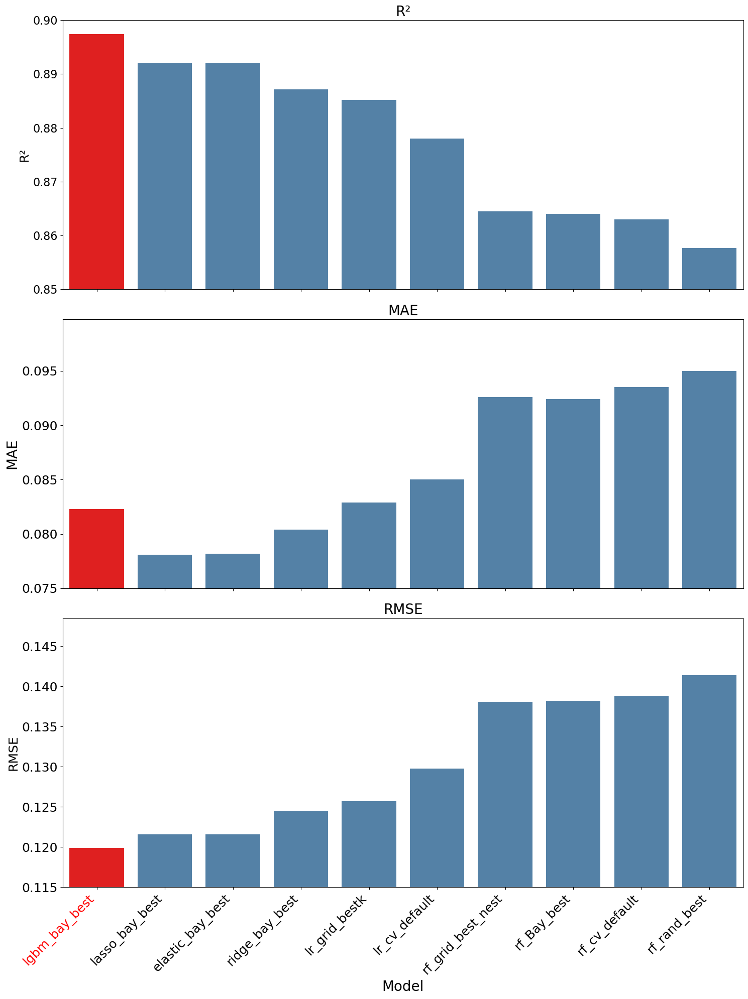

In [492]:
fig, axes = plt.subplots(3, 1, figsize=(15, 20))

# Prepare R² data
r2_data = model_compare_df1.reset_index(drop=True)

# Create a custom color palette 
r2_colors = ['red' if model == 'lgbm_bay_best' else 'steelblue' for model in r2_data['Model']]

sns.barplot(x=r2_data['Model'], y=r2_data['R²'], ax=axes[0], palette=r2_colors)
axes[0].set_xticklabels("")
# axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right', fontsize=18)
axes[0].tick_params(axis='y', labelsize=16)
axes[0].set_ylabel('R²',fontsize=18)
axes[0].set_xlabel("")
axes[0].set_title('R²', fontsize=20)
axes[0].set_ylim(0.85, 0.90)


mae_colors = ['red' if model == 'lgbm_bay_best' else 'steelblue' for model in model_compare_df1['Model']]
sns.barplot(x=model_compare_df1['Model'], y=model_compare_df1['MAE'], ax=axes[1], palette=mae_colors)
axes[1].set_xticklabels("")
# axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right', fontsize=18)
axes[1].tick_params(axis='y', labelsize=18)
axes[1].set_ylabel('MAE', fontsize=20)
axes[1].set_xlabel("")
axes[1].set_title('MAE', fontsize=20)
axes[1].set_ylim(bottom=0.075)

rmse_colors = ['red' if model == 'lgbm_bay_best' else 'steelblue' for model in model_compare_df1['Model']]
sns.barplot(x=model_compare_df1['Model'], y=model_compare_df1['RMSE'], ax=axes[2], palette=rmse_colors)
axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation=45, ha='right', fontsize=20)
axes[2].tick_params(axis='y', labelsize=18)
axes[2].set_xlabel('Model',fontsize=20)
axes[2].set_ylabel('RMSE', fontsize=18)
axes[2].set_title('RMSE', fontsize=20)
axes[2].set_ylim(bottom=0.115)
# Highlight specific x-tick
for tick_label in axes[2].get_xticklabels():
    if tick_label.get_text() == 'lgbm_bay_best':
        tick_label.set_color('red')
    tick_label.set_rotation(45)
    tick_label.set_ha('right')
    tick_label.set_fontsize(18)


plt.savefig("figures/Metrics_barplot.png", dpi=300, bbox_inches="tight")

plt.tight_layout()
plt.show()

The top three models based on R² are **lgbm_bay_best** (a LightGBM model with the optimal hyperparameters identified via Bayesian Optimization), **lasso_bay_best** (Lasso regression model optimized using Bayesian methods), and **elastic_bay_best** (ElasticNet regression model optimized using Bayesian methods). Notably, these models also achieve some of the lowest MAE and RMSE values, further reinforcing their strong predictive performance. 

## 4 Prediction of Testing dataset

### 4.1 Prediction generated using lgbm_bay_best model

In [359]:
y_test_pred = lgb_best_model.predict(tf_test.drop(columns='Id'))
real_sale_price = np.exp(y_test_pred)

In [360]:
tf_temp = tf_test.copy()
tf_temp['SalePrice'] = real_sale_price
submission_lgb_best = tf_temp[['Id', 'SalePrice']]

submission_lgb_best.to_csv("2nd_submission_lgb_best.csv", index=False)

### 4.2 Prediction generated using lasso_bay_best model

lasso_best_alpha = lasso_best_params['alpha'] 

lasso_best_model = Lasso(alpha=lasso_best_alpha, max_iter=5000)
lasso_best_model.fit(X_tf_train, y_tf_train)

y_test_pred2 = lasso_best_model.predict(tf_test.drop(columns='Id'))
real_sale_price2 = np.exp(y_test_pred2)

tf_temp = tf_test.copy()
tf_temp['SalePrice'] = real_sale_price2
submission_lasso_best = tf_temp[['Id', 'SalePrice']]

submission_lasso_best.to_csv("submission_lasso_best.csv", index=False)

## 5. Feature Importance under the best model 

![Screenshot of a comparison of three methods of feature importance calculation made by ChatGPT](Comparison_of_Feature_Importance_methods.jpg)

Recommendations:

- Use SHAP when you're explaining predictions to stakeholders, debugging, or selecting meaningful features.

- Use gain-based importance when optimizing or tuning the model.

- Use split-based only for rough inspection; do not rely on it for decision-making.

### 5.1 Built-in LightGBM Importance

#### 5.1.1 Built-in LightGBM split-based importances (Default Type)

To rank the features selected by my LightGBM model based on their importance after running the Optuna optimization, I can use LightGBM's built-in feature importance functionality. LightGBM provides two common types of feature importance: "split" (based on the number of times a feature is used in splits) and "gain" (based on the total gain of splits using the feature). The "gain" method is generally preferred as it better reflects the contribution of each feature to the model's performance.

Comparing to SHAP, this method can be less accurate than SHAP because they often count only how many times a feature is used in splits ("split" importance) Or how much it reduces loss ("gain" importance), which is better but still not as granular as SHAP.

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002485 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3419
[LightGBM] [Info] Number of data points in the train set: 1338, number of used features: 150
[LightGBM] [Info] Start training from score 12.063498
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

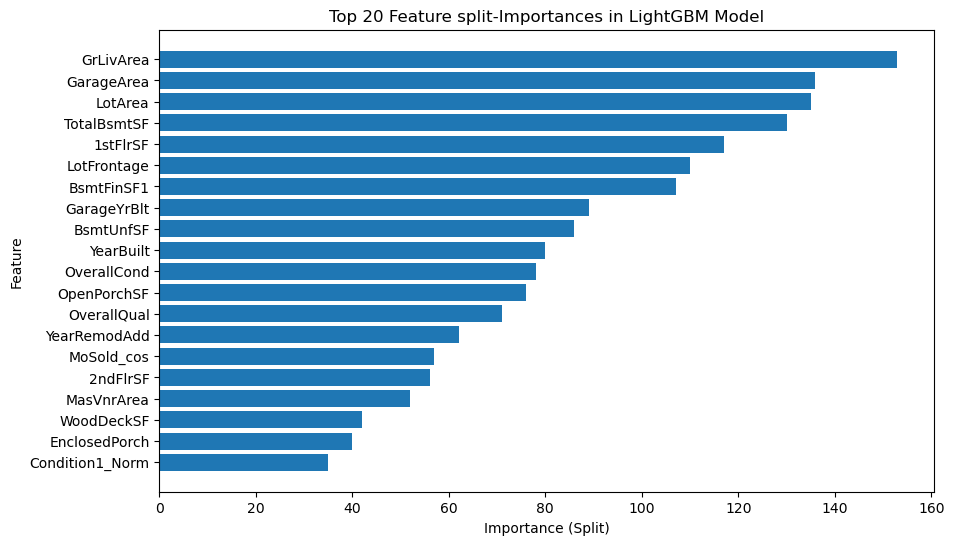

In [361]:
# Step 1: Train the final LightGBM model with the best parameters
lgb_best_model = lgb.LGBMRegressor(**lgb1_best_params, random_state=42)
lgb_best_model.fit(X_tf_train, y_tf_train)

# Step 2: Extract feature importances (using 'gain' for better insight)
feature_importances = lgb_best_model.feature_importances_
feature_names = X_tf_train.columns 

# Step 3: Create a DataFrame to rank features by importance
importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': feature_importances
})

# Sort by importance in descending order
importance_df = importance_df.sort_values(by='Importance', ascending=False).reset_index(drop=True)

# Step 4: Display the ranked features
print("Feature Importance Ranking (based on split):")
print(importance_df)

# Optional: Visualize the feature importances
plt.figure(figsize=(10, 6))
plt.barh(importance_df['Feature'][:20], importance_df['Importance'][:20])  # Top 20 features
plt.xlabel('Importance (Split)')
plt.ylabel('Feature')
plt.title('Top 20 Feature split-Importances in LightGBM Model')
plt.gca().invert_yaxis()  # Invert y-axis to show highest importance at the top
plt.show()

#### 5.1.2 Built-in LightGBM gain-based importances

Using LGBMRegressor but want full control (e.g., to get gain-based importances):

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002373 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3419
[LightGBM] [Info] Number of data points in the train set: 1338, number of used features: 150
[LightGBM] [Info] Start training from score 12.063498
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

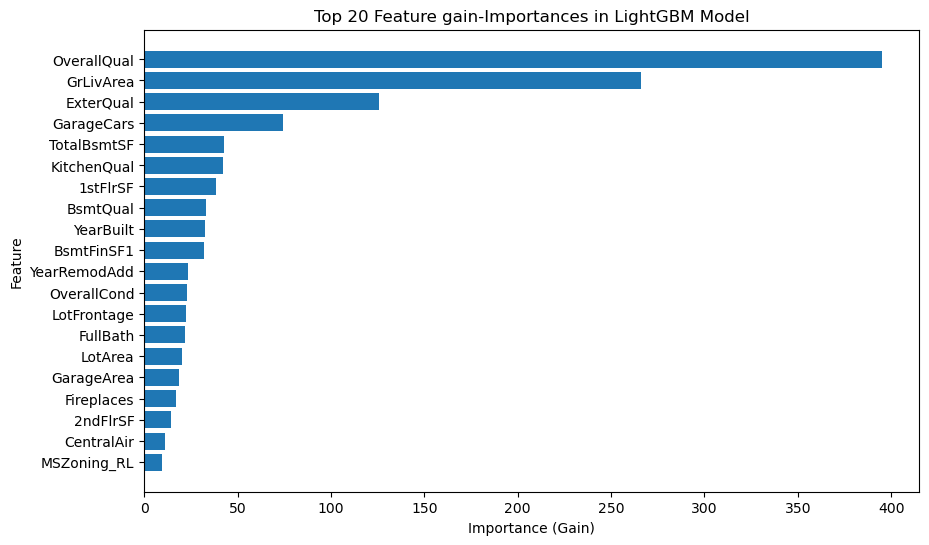

In [362]:
# Step 1: Train the final LightGBM model with the best parameters
lgb_best_model_gain = lgb.LGBMRegressor(**lgb1_best_params, importance_type='gain', random_state=42)
lgb_best_model_gain.fit(X_tf_train, y_tf_train)

# Step 2: Extract feature importances (using 'gain' for better insight)
feature_importances = lgb_best_model_gain.feature_importances_
feature_names = X_tf_train.columns 

# Step 3: Create a DataFrame to rank features by importance
importance_df_gain = pd.DataFrame({
    'Feature': feature_names,
    'Importance': feature_importances
})

# Sort by importance in descending order
importance_df_gain = importance_df_gain.sort_values(by='Importance', ascending=False).reset_index(drop=True)

# Step 4: Display the ranked features
print("Feature Importance Ranking (based on gain):")
print(importance_df_gain)

# Optional: Visualize the feature importances
plt.figure(figsize=(10, 6))
plt.barh(importance_df_gain['Feature'][:20], importance_df_gain['Importance'][:20])  # Top 20 features
plt.xlabel('Importance (Gain)')
plt.ylabel('Feature')
plt.title('Top 20 Feature gain-Importances in LightGBM Model')
plt.gca().invert_yaxis()  # Invert y-axis to show highest importance at the top
plt.show()

### 5.2 SHAP Feature Importance

#### 5.2.1 SHAP values

In [363]:
# pip install shap

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004168 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3419
[LightGBM] [Info] Number of data points in the train set: 1338, number of used features: 150
[LightGBM] [Info] Start training from score 12.063498
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

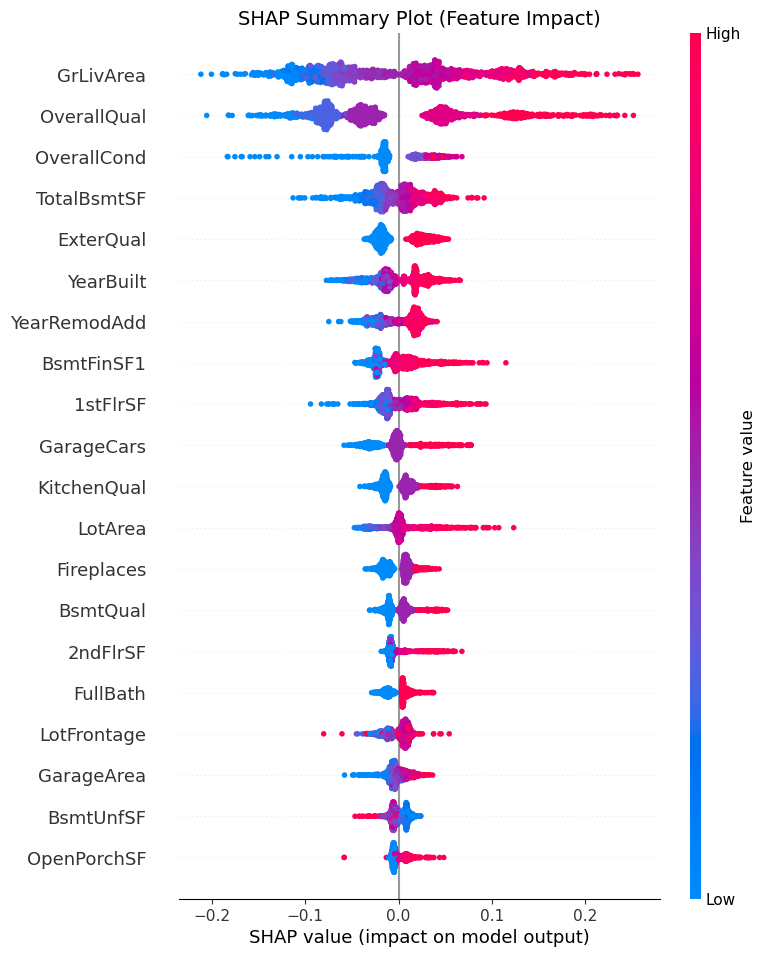

In [505]:

# Step 1: Train the final LightGBM model with the best parameters
lgb_best_model = lgb.LGBMRegressor(**lgb1_best_params, random_state=42)
lgb_best_model.fit(X_tf_train, y_tf_train)

# Step 2: Create SHAP explainer (tree explainer is optimized for LightGBM)
explainer = shap.Explainer(lgb_best_model, X_tf_train)

# Step 3: Compute SHAP values for the training data
shap_values = explainer(X_tf_train)

# Step 4: Visualize global feature importance
shap.summary_plot(shap_values, X_tf_train, show=False)
plt.title("SHAP Summary Plot (Feature Impact)", fontsize=14)
plt.savefig('figures/SHAP_Summary_Plot.jpg', dpi=300, bbox_inches="tight")
plt.show()


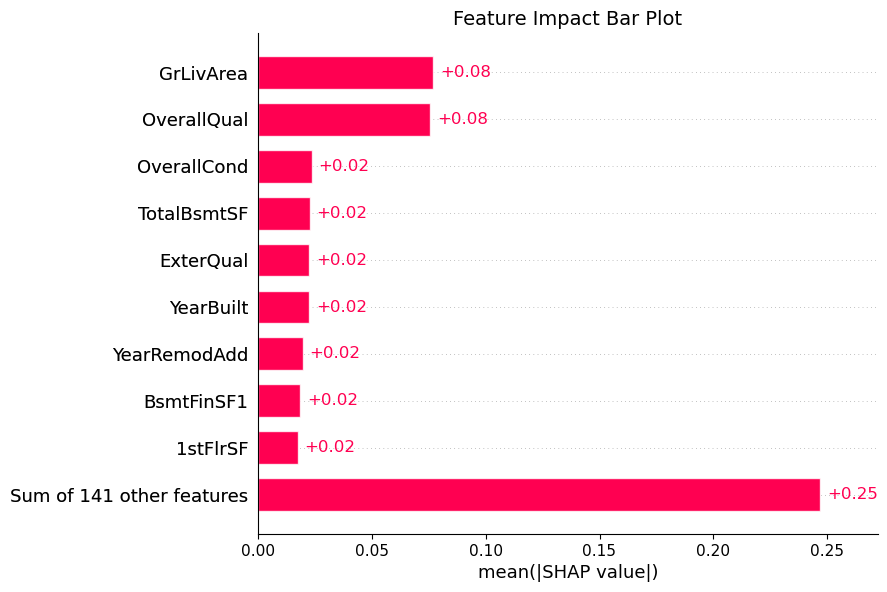

In [494]:
# Bar plot of mean absolute SHAP values
shap.plots.bar(shap_values, show=False)
plt.title("Feature Impact Bar Plot", fontsize=14)
plt.savefig('figures/SHAP_Bar_Plot.jpg', dpi=300, bbox_inches="tight")
plt.show()

##### 5.2.1.1 GrLivArea SHAP dependence plot

<Figure size 1000x600 with 0 Axes>

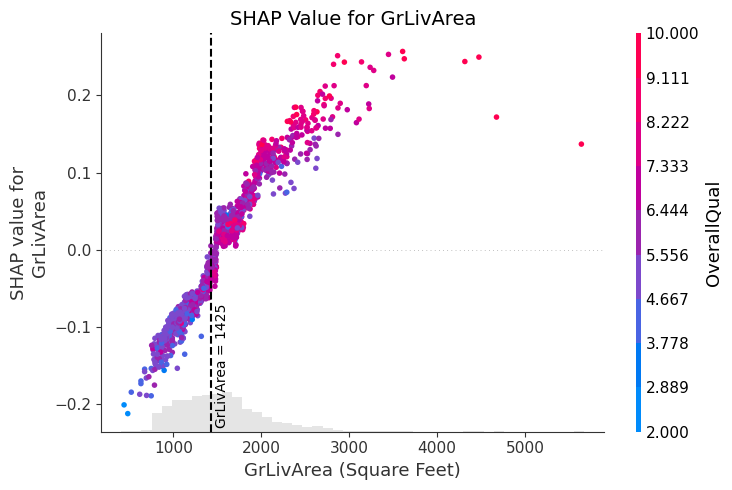

In [495]:
from sklearn.preprocessing import MinMaxScaler

# Recover original GrLivArea values by reversing the log transformation
grlivarea_original = np.expm1(shap_values[:, "GrLivArea"].data)

# Recover original OverallQual values by reversing the MinMaxScaler transformation
# Load the scaler and reverse
with open('fitted_scalers.pkl', 'rb') as f:
    loaded_scalers = pickle.load(f)
overallqual_scaler = loaded_scalers['OverallQual']
overallqual_scaled = shap_values[:, "OverallQual"].data.reshape(-1, 1)
overallqual_original = overallqual_scaler.inverse_transform(overallqual_scaled).flatten()

shap_overallqual = shap_values[:, "OverallQual"]
shap_overallqual.data = overallqual_original

# Create a new Explanation object with recovered GrLivArea values
shap_grlivarea = shap_values[:, "GrLivArea"]
shap_grlivarea.data = grlivarea_original

# Scatterplot 
plt.figure(figsize=(10, 6))
shap.plots.scatter(shap_grlivarea, color=shap_overallqual, show=False)

# Add crossover marker
crossover_grlivarea = shap_grlivarea.data[shap_grlivarea.values > 0].min()
plt.axvline(x=crossover_grlivarea, color='black', linestyle='--', linewidth=1.5)
plt.text(crossover_grlivarea + 50, -0.15, f'GrLivArea = {int(crossover_grlivarea)}', rotation=90,
         verticalalignment='center', color='black', fontsize=10)

plt.title("SHAP Value for GrLivArea", fontsize=14)
plt.xlabel("GrLivArea (Square Feet)")
plt.savefig('figures/SHAP_value_for_GrLivArea.jpg', dpi=300, bbox_inches="tight")
plt.tight_layout()
plt.show()

##### 5.2.1.2 OverallQual SHAP dependence plot

<Figure size 1000x600 with 0 Axes>

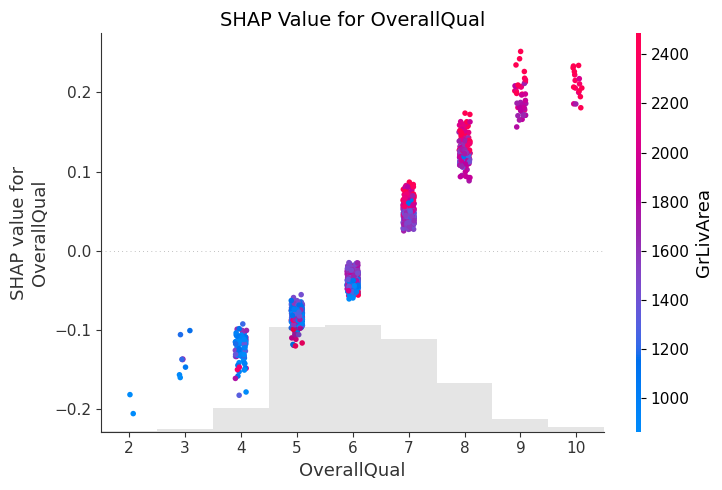

In [496]:
# Scatterplot
plt.figure(figsize=(10, 6))
shap.plots.scatter(shap_overallqual, color=shap_grlivarea, show=False)

plt.title("SHAP Value for OverallQual", fontsize=14)
plt.xlabel("OverallQual")
plt.savefig('figures/SHAP_value_for_OverallQual.jpg', dpi=300, bbox_inches="tight")
plt.tight_layout()
plt.show()


##### 5.2.1.3 OverallCond SHAP dependence plot

<Figure size 1000x600 with 0 Axes>

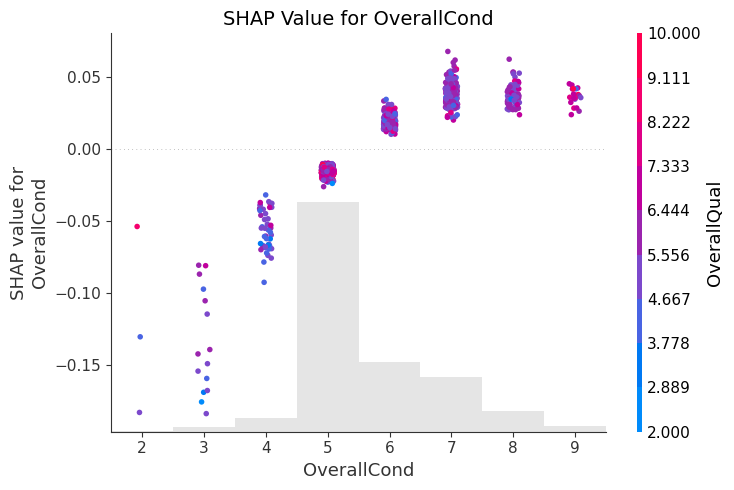

In [497]:
# Recover original OverallCond values by reversing the RobustScaler transformation
# Load the scaler and reverse
with open('fitted_scalers.pkl', 'rb') as f:
    loaded_scalers = pickle.load(f)
overallcond_scaler = loaded_scalers['OverallCond']
overallcond_scaled = shap_values[:, "OverallCond"].data.reshape(-1, 1)
overallcond_original = overallcond_scaler.inverse_transform(overallcond_scaled).flatten()

shap_overallcond = shap_values[:, "OverallCond"]
shap_overallcond.data = overallcond_original


# Scatterplot 
plt.figure(figsize=(10, 6))
shap.plots.scatter(shap_overallcond, color=shap_overallqual, show=False)

plt.title("SHAP Value for OverallCond", fontsize=14)
plt.xlabel("OverallCond")
plt.savefig('figures/SHAP_value_for_OverallCond.jpg', dpi=300, bbox_inches="tight")
plt.tight_layout()
plt.show()

##### 5.2.1.4 TotalBsmtSF SHAP dependence plot

<Figure size 1000x600 with 0 Axes>

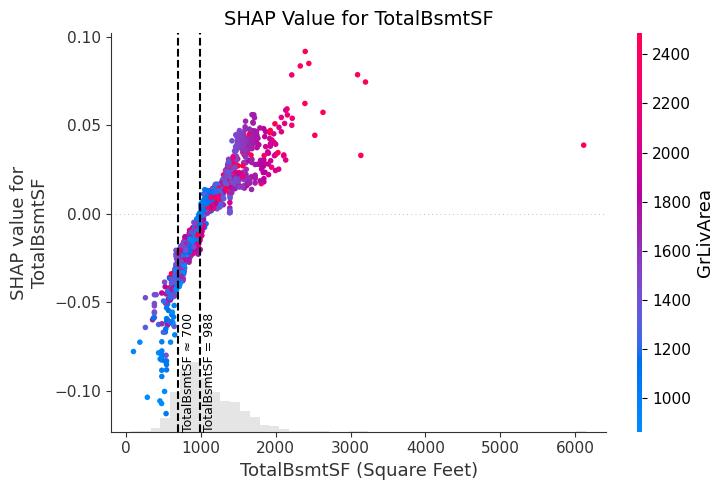

In [498]:
# Recover original TotalBsmtSF values by reversing the log transformation
Totalbsmtsf_original = np.expm1(shap_values[:, "TotalBsmtSF"].data)

# Create a new Explanation object with recovered GrLivArea values
shap_totalbsmtsf = shap_values[:, "TotalBsmtSF"]
shap_totalbsmtsf.data = Totalbsmtsf_original

# Scatterplot 
plt.figure(figsize=(10, 6))
shap.plots.scatter(shap_totalbsmtsf, color=shap_grlivarea, show=False)

# Add crossover marker
crossover_totalbsmtsf = shap_totalbsmtsf.data[shap_totalbsmtsf.values > 0].min()
plt.axvline(x=crossover_totalbsmtsf, color='black', linestyle='--', linewidth=1.5)
plt.text(crossover_totalbsmtsf + 50, -0.09, f'TotalBsmtSF = {int(crossover_totalbsmtsf)}', rotation=90,
         verticalalignment='center', color='black', fontsize=9)

# Second vertical line
plt.axvline(x=700, color='black', linestyle='--', linewidth=1.5)
plt.text(700 + 50, -0.09, 'TotalBsmtSF ≈ 700', rotation=90,
         verticalalignment='center', color='black', fontsize=9)

plt.title("SHAP Value for TotalBsmtSF", fontsize=14)
plt.xlabel("TotalBsmtSF (Square Feet)")
plt.savefig('figures/SHAP_value_for_TotalBsmtSF.jpg', dpi=300, bbox_inches="tight")
plt.tight_layout()
plt.show()

##### 5.2.1.5 ExterQual SHAP dependence plot

<Figure size 1000x600 with 0 Axes>

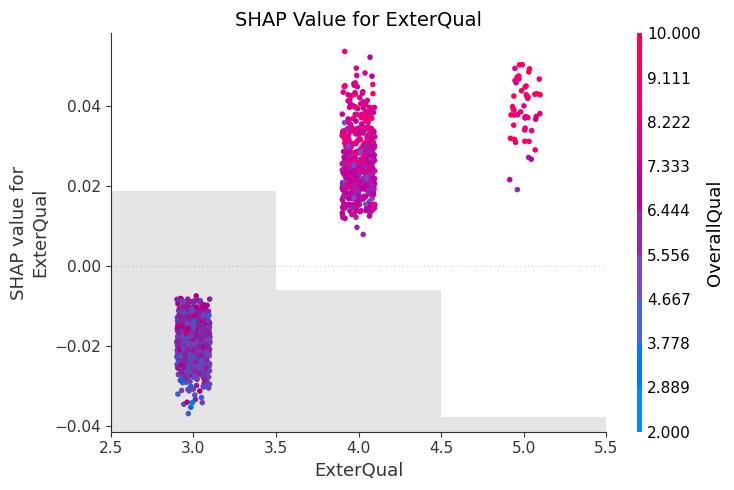

In [499]:

# Recover original ExterQual values by reversing the MinMaxScaler transformation
# Load the scaler and reverse
with open('fitted_scalers.pkl', 'rb') as f:
    loaded_scalers = pickle.load(f)
exterqual_scaler = loaded_scalers['ExterQual']
exterqual_scaled = shap_values[:, "ExterQual"].data.reshape(-1, 1)
exterqual_original = exterqual_scaler.inverse_transform(exterqual_scaled).flatten()

shap_exterqual = shap_values[:, "ExterQual"]
shap_exterqual.data = exterqual_original

# Scatterplot 
plt.figure(figsize=(10, 6))
shap.plots.scatter(shap_exterqual, color=shap_overallqual, show=False)

plt.title("SHAP Value for ExterQual", fontsize=14)
plt.xlabel("ExterQual")
plt.savefig('figures/SHAP_value_for_ExterQual.jpg', dpi=300, bbox_inches="tight")
plt.tight_layout()
plt.show()

##### 5.2.1.6 YearBuilt SHAP dependence plot

<Figure size 1000x600 with 0 Axes>

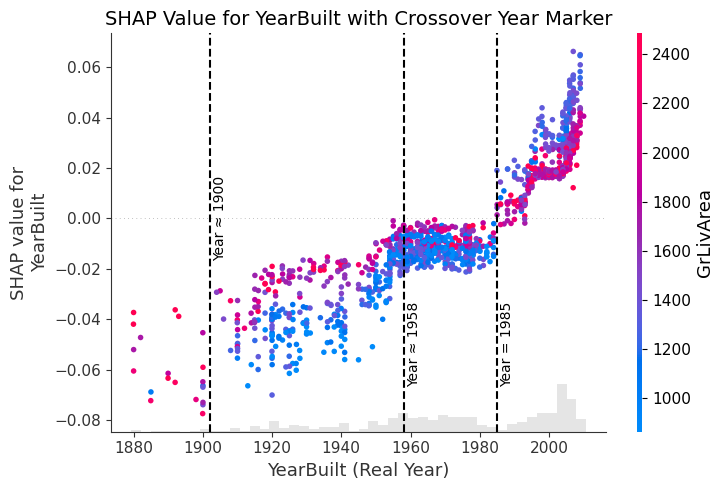

In [500]:
# Manually creating a new Explanation object to update .data field with real year
# Update the data field to reflect actual calendar years
shap_year_real = shap_values[:, "YearBuilt"]
updated_data = shap_year_real.data + 1880 # <-- convert to calendar 
shap_year_real = shap.Explanation(
    values=shap_year_real.values,
    base_values=shap_year_real.base_values,
    data=updated_data,  
    feature_names=shap_year_real.feature_names
)

# Recover original GrLivArea values by reversing the log transformation
grlivarea_original = np.expm1(shap_values[:, "GrLivArea"].data)
# Create a new Explanation object with recovered GrLivArea values
shap_grlivarea = shap_values[:, "GrLivArea"]
shap_grlivarea.data = grlivarea_original

# Scatterplot with vertical line at the crossover year
plt.figure(figsize=(10, 6))
shap.plots.scatter(shap_year_real, color=shap_grlivarea, show=False)

# Add crossover marker
crossover_year = shap_year_real.data[shap_year_real.values > 0].min()
plt.axvline(x=crossover_year, color='black', linestyle='--', linewidth=1.5)
plt.text(crossover_year + 1, -0.05, f'Year = {int(crossover_year)}', rotation=90,
         verticalalignment='center', color='black', fontsize=10)

# Second vertical line at 1902
plt.axvline(x=1902, color='black', linestyle='--', linewidth=1.5)
plt.text(1902 + 1, -0.00, 'Year ≈ 1900', rotation=90,
         verticalalignment='center', color='black', fontsize=10)

# Third vertical line at 1958
plt.axvline(x=1958, color='black', linestyle='--', linewidth=1.5)
plt.text(1958 + 1, -0.05, 'Year ≈ 1958', rotation=90,
         verticalalignment='center', color='black', fontsize=10)

plt.title("SHAP Value for YearBuilt with Crossover Year Marker", fontsize=14)
plt.xlabel("YearBuilt (Real Year)")
plt.savefig('figures/SHAP_value_for_YearBuilt.jpg', dpi=300, bbox_inches="tight")
plt.tight_layout()
plt.show()

##### 5.2.1.7 YearRemodAdd SHAP dependence plot

<Figure size 1000x600 with 0 Axes>

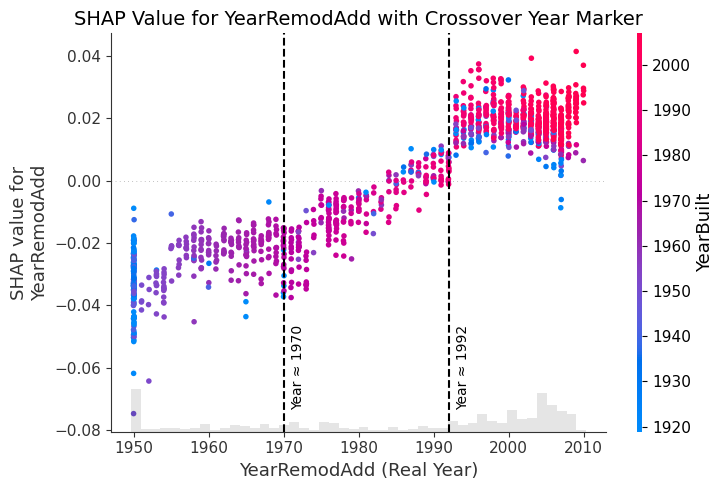

In [501]:
# Manually creating a new Explanation object to update .data field with actual calendar years
# reference year for YearRemodAdd is 1950
shap_yearremod_real = shap_values[:, "YearRemodAdd"]
updated_data = shap_yearremod_real.data + 1950 # <-- convert to calendar 
shap_yearremod_real = shap.Explanation(
    values=shap_yearremod_real.values,
    base_values=shap_yearremod_real.base_values,
    data=updated_data,  
    feature_names=shap_yearremod_real.feature_names
)

# Scatterplot with vertical line at the crossover year
plt.figure(figsize=(10, 6))
shap.plots.scatter(shap_yearremod_real, color=shap_year_real, show=False)

# First vertical line at 1970
plt.axvline(x=1970, color='black', linestyle='--', linewidth=1.5)
plt.text(1970 + 1, -0.06, 'Year ≈ 1970', rotation=90,
         verticalalignment='center', color='black', fontsize=10)

# Second vertical line at 1992
plt.axvline(x=1992, color='black', linestyle='--', linewidth=1.5)
plt.text(1992 + 1, -0.06, 'Year ≈ 1992', rotation=90,
         verticalalignment='center', color='black', fontsize=10)


plt.title("SHAP Value for YearRemodAdd with Crossover Year Marker", fontsize=14)
plt.xlabel("YearRemodAdd (Real Year)")
plt.savefig('figures/SHAP_value_for_YearRemodAdd.jpg', dpi=300, bbox_inches="tight")
plt.tight_layout()
plt.show()



##### 5.2.1.8 BsmtFinSF1 SHAP dependence plot 

<Figure size 1000x600 with 0 Axes>

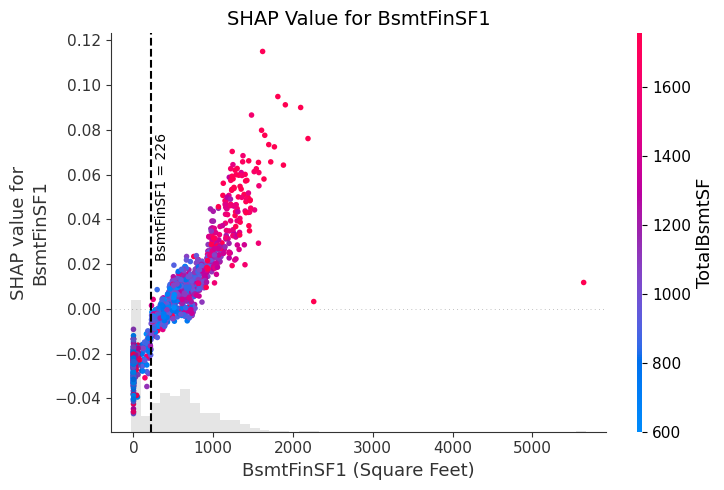

In [502]:
# Recover original BsmtFinSF1 values by reversing the log transformation
bsmtfinsf1_original = np.expm1(shap_values[:, "BsmtFinSF1"].data)

# Create a new Explanation object with recovered BsmtFinSF1 values
shap_bsmtfinsf1 = shap_values[:, "BsmtFinSF1"]
shap_bsmtfinsf1.data = bsmtfinsf1_original

# Scatterplot 
plt.figure(figsize=(10, 6))
shap.plots.scatter(shap_bsmtfinsf1, color=shap_totalbsmtsf, show=False)

# Add crossover marker
crossover_bsmtfinsf1 = shap_bsmtfinsf1.data[shap_bsmtfinsf1.values > 0].min()
plt.axvline(x=crossover_bsmtfinsf1, color='black', linestyle='--', linewidth=1.5)
plt.text(crossover_bsmtfinsf1 + 50, 0.05, f'BsmtFinSF1 = {int(crossover_bsmtfinsf1)}', rotation=90,
         verticalalignment='center', color='black', fontsize=10)

plt.title("SHAP Value for BsmtFinSF1", fontsize=14)
plt.xlabel("BsmtFinSF1 (Square Feet)")
plt.savefig('figures/SHAP_value_for_BsmtFinSF1.jpg', dpi=300, bbox_inches="tight")
plt.tight_layout()
plt.show()

##### 5.2.1.9 1stFlrSF SHAP dependence plot

<Figure size 1000x600 with 0 Axes>

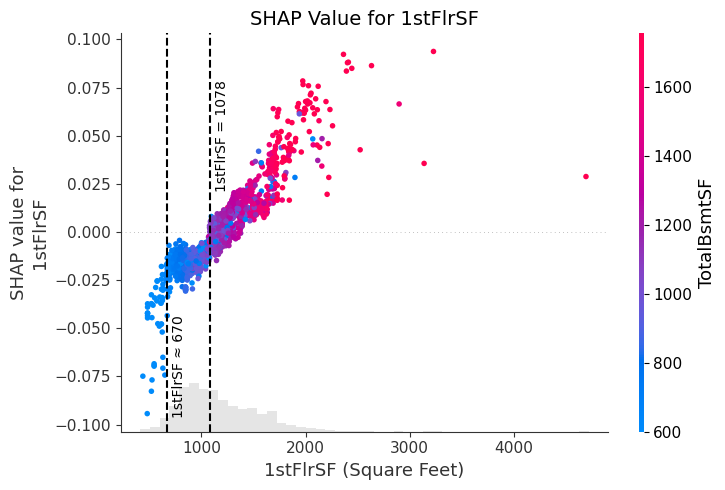

In [503]:
# Recover original 1stFlrSF values by reversing the log transformation
firstflrsf_original = np.expm1(shap_values[:, "1stFlrSF"].data)

# Create a new Explanation object with recovered 1stFlrSF values
shap_firstflrsf = shap_values[:, "1stFlrSF"]
shap_firstflrsf.data = firstflrsf_original

# Scatterplot 
plt.figure(figsize=(10, 6))
shap.plots.scatter(shap_firstflrsf, color=shap_totalbsmtsf, show=False)

# Add crossover marker
crossover_firstflrsf = shap_firstflrsf.data[shap_firstflrsf.values > 0].min()
plt.axvline(x=crossover_firstflrsf, color='black', linestyle='--', linewidth=1.5)
plt.text(crossover_firstflrsf + 50, 0.05, f'1stFlrSF = {int(crossover_firstflrsf)}', rotation=90,
         verticalalignment='center', color='black', fontsize=10)

# Second vertical line 
plt.axvline(x=670, color='black', linestyle='--', linewidth=1.5)
plt.text(670 + 50, -0.07, '1stFlrSF ≈ 670', rotation=90,
         verticalalignment='center', color='black', fontsize=10)

plt.title("SHAP Value for 1stFlrSF", fontsize=14)
plt.xlabel("1stFlrSF (Square Feet)")
plt.savefig('figures/SHAP_value_for_1stFlrSF.jpg', dpi=300, bbox_inches="tight")
plt.tight_layout()
plt.show()

##### 5.2.1.10 GarageCars SHAP dependence plot

<Figure size 1000x600 with 0 Axes>

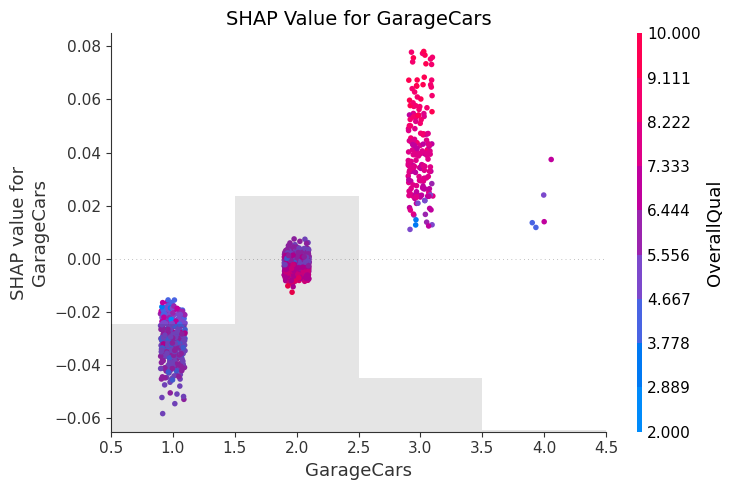

In [504]:
# Recover original GarageCars values by reversing the MinMaxScaler transformation
# Load the scaler and reverse
with open('fitted_scalers.pkl', 'rb') as f:
    loaded_scalers = pickle.load(f)
garagecars_scaler = loaded_scalers['GarageCars']
garagecars_scaled = shap_values[:, "GarageCars"].data.reshape(-1, 1)
garagecars_original = garagecars_scaler.inverse_transform(garagecars_scaled).flatten()

shap_garagecars = shap_values[:, "GarageCars"]
shap_garagecars.data = garagecars_original

# Scatterplot 
plt.figure(figsize=(10, 6))
shap.plots.scatter(shap_garagecars, color=shap_overallqual, show=False)

plt.title("SHAP Value for GarageCars", fontsize=14)
plt.xlabel("GarageCars")
plt.savefig('figures/SHAP_value_for_GarageCars.jpg', dpi=300, bbox_inches="tight")
plt.tight_layout()
plt.show()

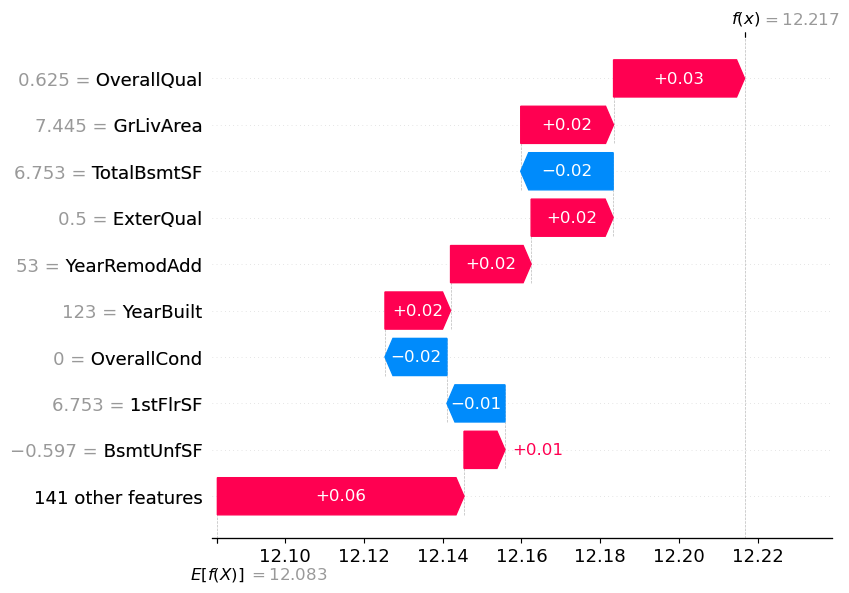

In [370]:
# explanation for the first prediction
shap.plots.waterfall(shap_values[0])  

In the waterfall plot, E[f(x)] is the average predicted sale price across all observations, f(x) is the predicted sale price for this particular observation. The Shap values are all these values in between they tell us how each module feature has contributed to the difference between the prediction and the average prediction. All these numbers on the left of each feature are the actual feature values. 

In [371]:
shap_values.shape

(1338, 150)

This Youtube video has more clear explaination on each plot [SHAP with Python (Code and Explanations)](https://youtu.be/L8_sVRhBDLU)

![Snapshot of cross_comparison_summary made by CHATGPT](Cross_comparison_summary.jpg)

#### 5.2.2 Convert SHAP to Dollar (not final yet, the conversion math part may not be correct.)

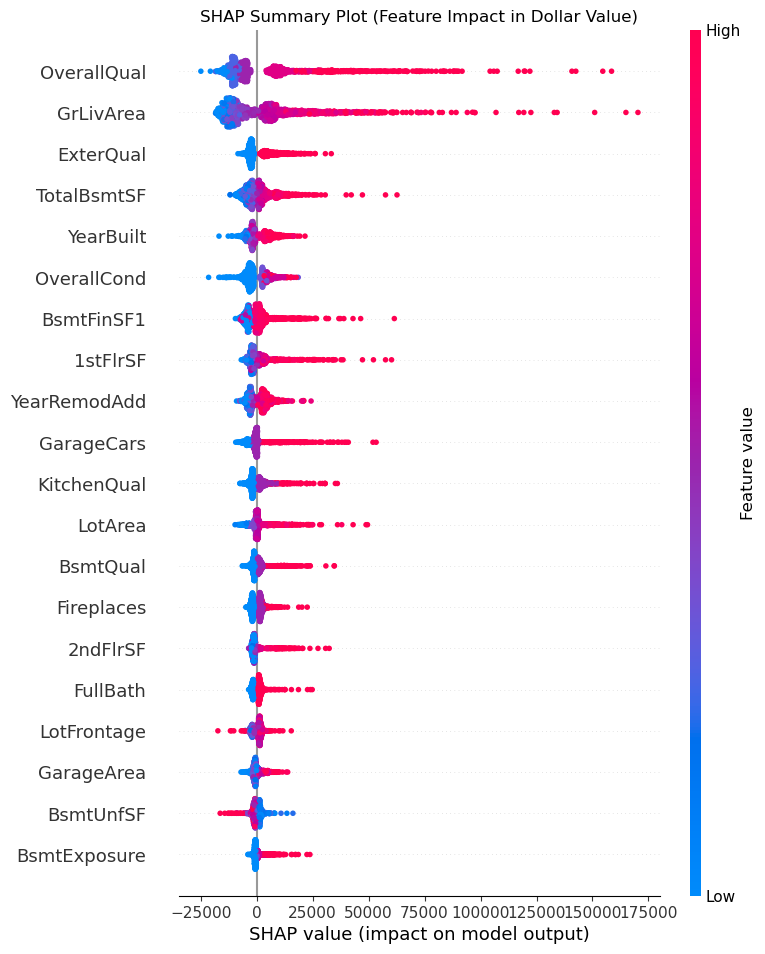

In [386]:
# Load sample SHAP explainer using the model and training data
explainer = shap.Explainer(lgb_best_model, X_tf_train)
shap_values = explainer(X_tf_train)

# Convert model predictions from log-price to price
y_train_pred = lgb_best_model.predict(X_tf_train)
price_pred_train = np.expm1(y_train_pred)

# Convert SHAP values from log-price units to dollar impact
shap_dollar_values = shap_values.values * price_pred_train[:, np.newaxis]

# Create a new SHAP object for visualization using dollar-impact values
shap_dollar = shap.Explanation(
    values=shap_dollar_values,
    base_values=price_pred_train,
    data=X_tf_train.values,
    feature_names=X_tf_train.columns.tolist()
)

# Plot the custom dollar-based SHAP summary (beeswarm-like) plot
plt.figure(figsize=(10, 8))
shap.summary_plot(shap_dollar, X_tf_train, show=False)
plt.title("SHAP Summary Plot (Feature Impact in Dollar Value)")
plt.show()


A skewed SHAP summary plot can highlight dominant features with high impact, making it easier to quickly identify which features most influence the model's predictions. However, skewed distributions can obscure the contributions of less dominant features and may exaggerate the importance of outliers, leading to a misleading interpretation of feature effects. Transitioning to a centered SHAP summary plot helps address this by aligning SHAP values around zero, which clarifies whether a feature generally increases or decreases the prediction. This centering provides a more balanced view of each feature’s directional influence, making it easier to compare their effects across the dataset and supporting more interpretable, fair conclusions about model behavior.

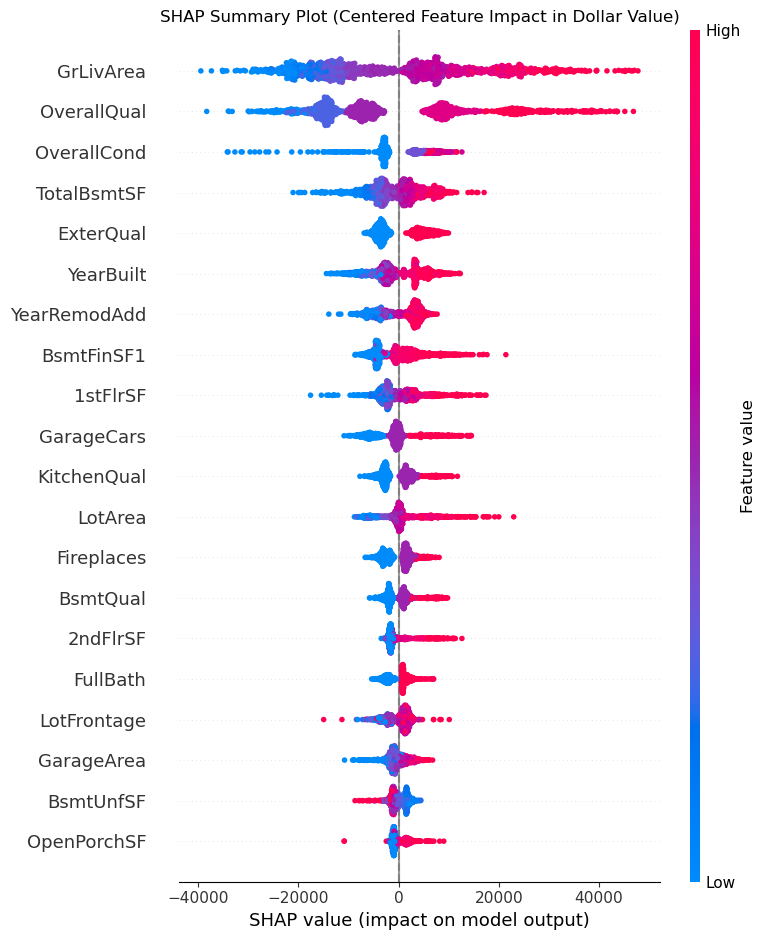

In [373]:
# Use a constant average predicted price to preserve SHAP symmetry
avg_price = np.mean(price_pred_train)  # Or use median for robustness

# Convert SHAP values from log-units to dollar impact (centered)
shap_dollar_values_cen = shap_values.values * avg_price

# Step 4: Build SHAP Explanation object with centered dollar values
shap_dollar = shap.Explanation(
    values=shap_dollar_values_cen,
    base_values=np.full_like(y_train_pred, avg_price),  # constant base value
    data=X_tf_train.values,
    feature_names=X_tf_train.columns.tolist()
)

# Step 5: Plot the centered SHAP dollar summary
plt.figure(figsize=(10, 8))
shap.summary_plot(shap_dollar, X_tf_train, show=False)
plt.title("SHAP Summary Plot (Centered Feature Impact in Dollar Value)")
plt.axvline(0, color='gray', linestyle='--')  # Optional: add vertical 0 line
plt.tight_layout()
plt.show()

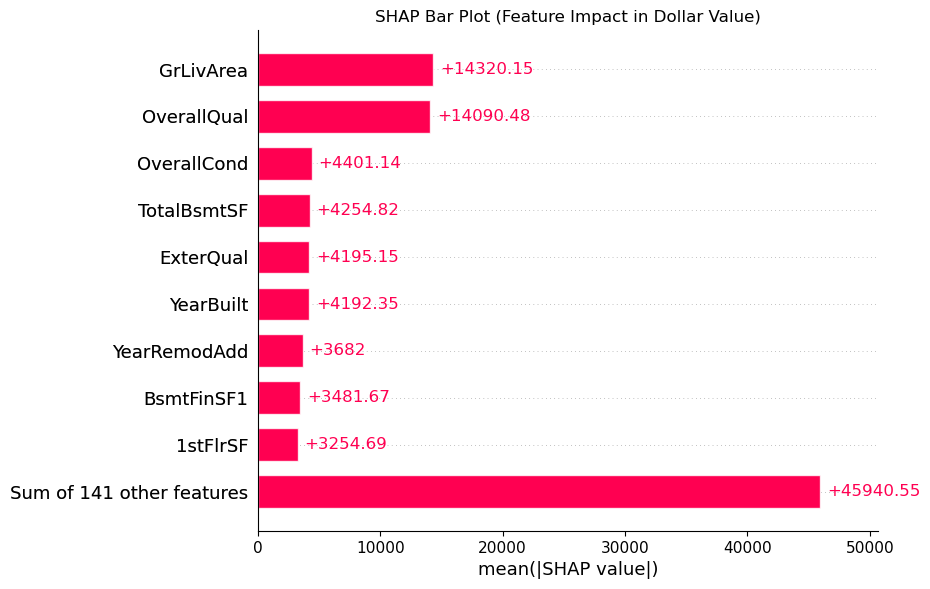

In [374]:
# Bar plot of mean absolute SHAP values
shap.plots.bar(shap_dollar, show=False)
plt.title("SHAP Bar Plot (Feature Impact in Dollar Value)")
plt.show()

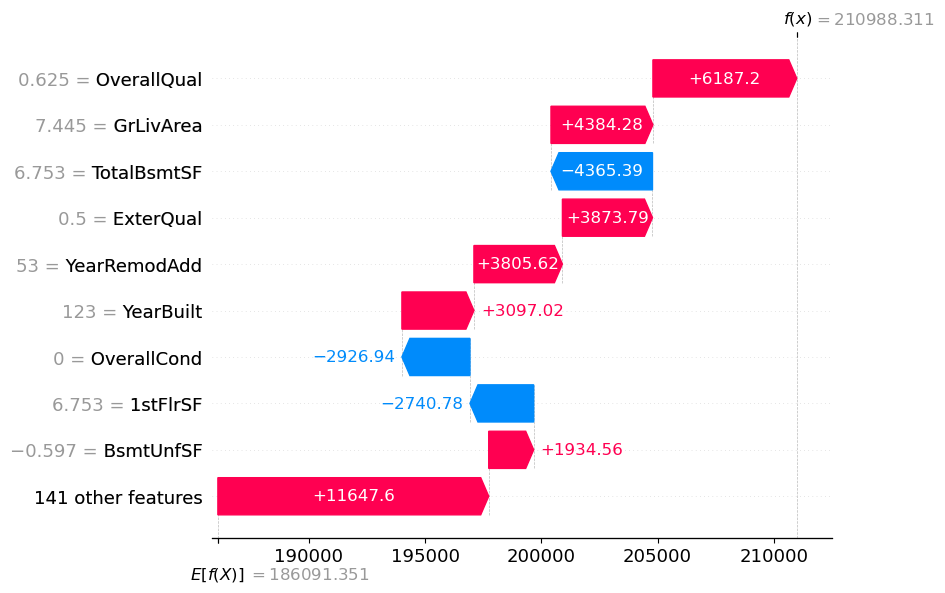

In [375]:
# explanation for the first prediction
shap.plots.waterfall(shap_dollar[0])  

<Figure size 1000x600 with 0 Axes>

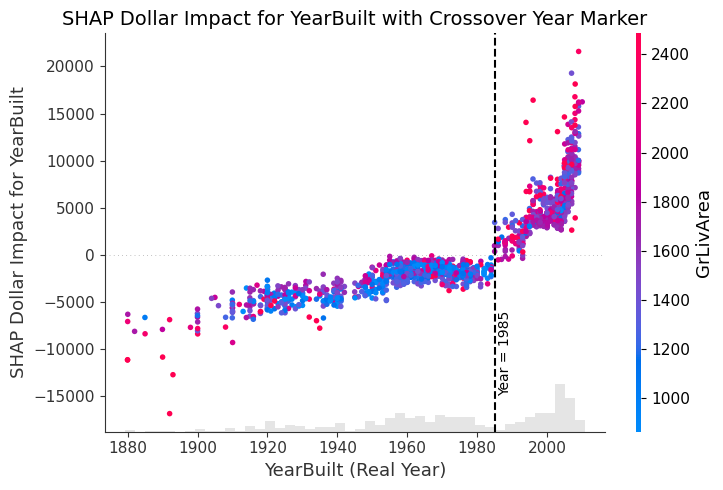

In [376]:
# Convert model predictions from log-price to price
y_train_pred = lgb_best_model.predict(X_tf_train)
price_pred_train = np.expm1(y_train_pred)

# Convert SHAP values from log-price units to dollar impact
shap_dollar_values = shap_values.values * price_pred_train[:, np.newaxis]

# Extract the 1D Explanation object for "YearBuilt"
shap_year_real = shap_values[:, "YearBuilt"]

# Update the data field to reflect actual calendar overallqual
updated_data = shap_year_real.data + 1880

# Find the index of "YearBuilt" in shap_values.feature_names
year_built_index = shap_values.feature_names.index("YearBuilt")

# Extract the SHAP dollar values for "YearBuilt"
shap_dollar_values_year_built = shap_dollar_values[:, year_built_index]

# Create a new Explanation object with updated .data and .values
shap_year_real = shap.Explanation(
    values=shap_dollar_values_year_built,  # Use SHAP dollar values
    base_values=shap_year_real.base_values,
    data=updated_data,  # Calendar overallqual
    feature_names=shap_year_real.feature_names
)
# Recover original GrLivArea values by reversing the log transformation
grlivarea_original = np.expm1(shap_values[:, "GrLivArea"].data)
# Create a new Explanation object with recovered GrLivArea values
shap_grlivarea = shap_values[:, "GrLivArea"]
shap_grlivarea.data = grlivarea_original

# Scatterplot with vertical line at the crossover year
plt.figure(figsize=(10, 6))
shap.plots.scatter(shap_year_real, color=shap_grlivarea, show=False)

# Add crossover marker
crossover_year = shap_year_real.data[shap_year_real.values > 0].min()
plt.axvline(x=crossover_year, color='black', linestyle='--', linewidth=1.5)
plt.text(crossover_year + 1, -15000, f'Year = {int(crossover_year)}', rotation=90,
         verticalalignment='bottom', color='black', fontsize=10)

# Update title and labels to reflect dollar amounts
plt.title("SHAP Dollar Impact for YearBuilt with Crossover Year Marker", fontsize=14)
plt.ylabel("SHAP Dollar Impact for YearBuilt")
plt.xlabel("YearBuilt (Real Year)")

plt.tight_layout()
plt.show()

<Figure size 1000x600 with 0 Axes>

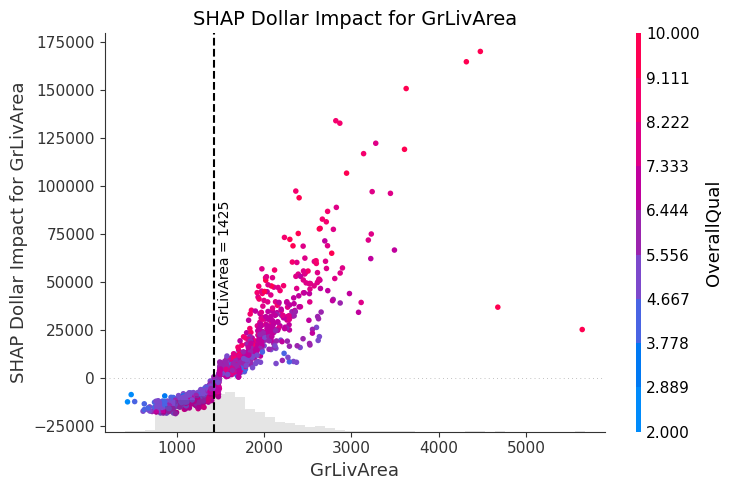

In [377]:
# Update the explaination.data with original OverallQual values by reversing the MinMaxScaler transformation
# Load the scaler 
with open('fitted_scalers.pkl', 'rb') as f:
    loaded_scalers = pickle.load(f)
overallqual_scaler = loaded_scalers['OverallQual']
# reverse to original OverallQual values
overallqual_scaled = shap_values[:, "OverallQual"].data.reshape(-1, 1)
overallqual_original = overallqual_scaler.inverse_transform(overallqual_scaled).flatten()
# Update the explaination.data with original OverallQual values 
shap_overallqual = shap_values[:, "OverallQual"]
shap_overallqual.data = overallqual_original

# Convert SHAP values from log-price units to dollar impact
# Convert model predictions from log-price to price
price_pred_train = np.expm1(y_train_pred)
# Convert SHAP values from log-price units to dollar impact
shap_dollar_values = shap_values.values * price_pred_train[:, np.newaxis]
# Find the index of "GrLivArea" in shap_values.feature_names
grlivarea_index = shap_values.feature_names.index("GrLivArea")
# Extract the SHAP dollar impact values for "GrLivArea"
shap_dollar_values_grlivarea = shap_dollar_values[:, grlivarea_index]

# Recover original GrLivArea values by reversing the log transformation
grlivarea_original = np.expm1(shap_values[:, "GrLivArea"].data)

# Update SHAP Dollar values and GrLiveArea original values in GrlivArea Explanation object
shap_grlivarea = shap_values[:, "GrLivArea"]
shap_grlivarea.values = shap_dollar_values_grlivarea
shap_grlivarea.data = grlivarea_original

# Scatterplot
plt.figure(figsize=(10, 6))
shap.plots.scatter(shap_grlivarea, color=shap_overallqual, show=False)

# Add crossover marker
crossover_grlivarea = shap_grlivarea.data[shap_grlivarea.values > 0].min()
plt.axvline(x=crossover_grlivarea, color='black', linestyle='--', linewidth=1.5)
plt.text(crossover_grlivarea + 50, 60000, f'GrLivArea = {int(crossover_grlivarea)}', rotation=90,
         verticalalignment='center', color='black', fontsize=10)

# Update title and labels to reflect dollar amounts
plt.title("SHAP Dollar Impact for GrLivArea", fontsize=14)
plt.ylabel("SHAP Dollar Impact for GrLivArea")
plt.xlabel("GrLivArea")

plt.tight_layout()
plt.show()

<Figure size 1000x600 with 0 Axes>

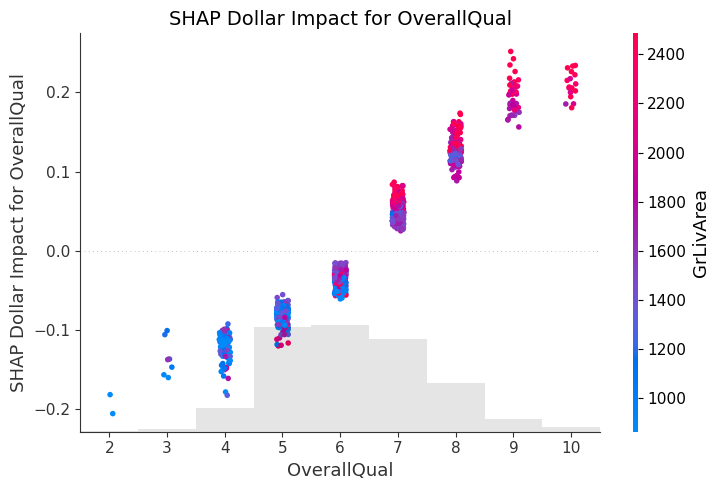

In [379]:
# Scatterplot 
plt.figure(figsize=(10, 6))
shap.plots.scatter(shap_overallqual, color=shap_grlivarea, show=False)

# Update title and labels to reflect dollar amounts
plt.title("SHAP Dollar Impact for OverallQual", fontsize=14)
plt.ylabel("SHAP Dollar Impact for OverallQual")
plt.xlabel("OverallQual")

plt.tight_layout()
plt.show()

In [380]:
# Check the range of the scaled OverallQual data
overallqual_scaled = shap_values[:, "OverallQual"].data
print("Scaled OverallQual min:", overallqual_scaled.min())
print("Scaled OverallQual max:", overallqual_scaled.max())

Scaled OverallQual min: 0.0
Scaled OverallQual max: 1.0


## 6. Save

In [381]:
import joblib

# Save model
joblib.dump(lgb_best_model, "lgb_best_model.pkl")

# Load model later
# loaded_model = joblib.load("lgb_best_model.pkl")

# Save Preprocessed Data
joblib.dump(X_tf_train, "X_tf_train.pkl")
joblib.dump(y_tf_train, "y_tf_train.pkl")

['y_tf_train.pkl']

In [398]:
import dill

with open("session.pkl", "wb") as f:
    dill.dump_session(f)
    # ensures the data is fully written to disk before you close the program.
    f.flush()
    os.fsync(f.fileno())

In [399]:
import os
print(os.path.getsize("session.pkl"))

289221613


In [384]:
import dill
import shutil

# Backup first!
shutil.copy("session.pkl", "session_backup.pkl")

# Then load
dill.load_session("session.pkl")

UnpicklingError: pickle data was truncated